Google Colab Link: https://colab.research.google.com/drive/1gOHd25FhFpcn-vwZkNWcUWO0S2OuJ6G2?usp=sharing

In [ ]:
import datetime
from google.colab import files as FILE
import ipywidgets as widgets
from ipywidgets import interact,interactive, fixed, interact_manual, Layout
import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image
import tensorflow as tf
import time
from tqdm import tqdm

#Download Images

Content Image: Left, Style Image: Right


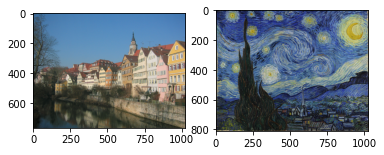

In [ ]:
#Upload your own Pictures or use the default pictures. 
img_dir = '/tmp/nst'
if not os.path.exists(img_dir):
    os.makedirs(img_dir)
own_Pictures=False #@param {type:"boolean"}

if own_Pictures:
  print("Choose a file to use as your content image:\r")
  content = FILE.upload()
  content_img = Image.open(list(content.keys())[0])
  content_path = list(content.keys())[0]
else:
  #download content images
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/d/d7/Green_Sea_Turtle_grazing_seagrass.jpg
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/0/00/Tuebingen_Neckarfront.jpg
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/4/47/Vassily_Kandinsky%2C_1923_-_Composition_8%2C_huile_sur_toile%2C_140_cm_x_201_cm%2C_Mus%C3%A9e_Guggenheim%2C_New_York.jpg
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/thumb/e/ea/Caspar_David_Friedrich_-_Zwei_M%C3%A4nner_in_Betrachtung_des_Mondes.jpg/1024px-Caspar_David_Friedrich_-_Zwei_M%C3%A4nner_in_Betrachtung_des_Mondes.jpg

  #content_path = '/tmp/nst/Green_Sea_Turtle_grazing_seagrass.jpg'
  content_path = '/tmp/nst/Tuebingen_Neckarfront.jpg'
  content_img = Image.open(content_path)
  
if own_Pictures:
  print("Choose a file to use as your style image:\r")
  style = FILE.upload()
  style_img = Image.open(list(style.keys())[0])
  style_path =  list(style.keys())[0]
else:
  #download style images
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/0/0a/The_Great_Wave_off_Kanagawa.jpg
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/thumb/e/ea/Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg
  !wget --quiet -P /tmp/nst/ https://upload.wikimedia.org/wikipedia/commons/b/b4/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg
  #style_path = '/tmp/nst/The_Great_Wave_off_Kanagawa.jpg'
  style_path = '/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg'
  #style_path = '/tmp/nst/Vassily_Kandinsky,_1913_-_Composition_7.jpg'
  style_img = Image.open(style_path)

plt.subplot(1, 2, 1)
plt.imshow(content_img)
plt.subplot(1, 2, 2)
plt.imshow(style_img)

print("Content Image: Left, Style Image: Right")

#Preprocess images

In [ ]:
def normalize_0_1(x):
  """
  This function normalizes the values off an input tensor on to a range from 0 to 1.

  @params
  x: input tensor

  @return
  normalized tensor
  """
  #range 0 to 1
  max = tf.math.reduce_max(x)
  min = tf.math.reduce_min(x)
  result = tf.math.subtract(x, min)
  result = tf.math.divide(result,(max-min))
  return(result)  

def standardize(x, mean, std):
  """
  This function standardizes an input tensor by substracting and dividing with a given mean, standard deviation

  @params
  x: input tensor
  mean: arithmetic mean
  std: standard deviation

  @return
  standardized tensor
  """
  x = tf.math.subtract(x, mean)
  x = tf.math.divide(x, std)
  return x

In [ ]:
def preprocess_image(img, img_size = [512,512], vgg19 = False):
  """
  This is the basic image preprocessing function

  @params
  img: input image, 3-D int tensor [RGB] 
  img_size: target image size [height, width]
  vgg19: boolean, whether to perform VGG19 preprocessing 
  
  @return
  preprocessed float image [0,255] 
  """
  #Convert jpg to tensor
  img = tf.convert_to_tensor(np.array(img))
  if vgg19:
    #Change RGB channel to BGR channel
    img = tf.keras.applications.vgg19.preprocess_input(img)
    #img = tf.reverse(img, axis = [-1]) #this is equivalent to vgg19 preprocessing
  img = normalize_0_1(img)
  #subtract imagenet mean
  img = standardize(img, mean=[0.40760392, 0.45795686, 0.48501961], std=[1,1,1])
  #scale back to [0,255]
  img = tf.multiply(img, 255)
  #resize
  img = tf.image.resize(img, img_size)
  
  return img

In [ ]:
def imshow(img, title=None, dtype=tf.dtypes.int32):
  """
  basic image plotting function

  @params
  img: image
  title: potential title
  dtype: data type 

  @return
  none
  """
  out = img
  if img.ndim == 4:
     #remove the batch dimension
    out = tf.squeeze(img, axis = 0)
  #cast into target data type
  out = tf.cast(out, dtype=dtype)
  if title is not None:
    #set title
    plt.title(title)
  #show plot
  plt.imshow(out)
  plt.show()

In [ ]:
def reverse_preprocess(img, vgg19=True, clip = True):
  #
  """
  a function to reverse the preprocessing

  @params
  img: image
  vgg19: whether vgg19 preprocessing was performed on the image
  clip: where to clip the image to [0,1] after deprocessing for plotting purposes

  @return
  reversed processed image
  """
  #denormalize to [0,1]
  tmp = tf.math.divide(img, 255) 
  if vgg19:
    #add imagenet means back again
    tmp = standardize(tmp, mean = [-0.40760392, -0.45795686, -0.48501961], std =[1,1,1])
    #switch back from BGR to RGB
    tmp = tf.reverse(tmp, axis = [-1])
  if clip:
    #clip to [0,1] for plotting
    tmp = tf.clip_by_value(tmp, 0, 1)
  return tmp


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


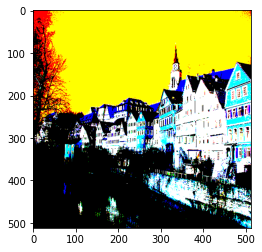

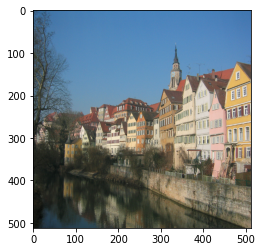

In [ ]:
#test preprocess and deprocess functions
img = content_img
tmp = preprocess_image(img, vgg19=True)
imshow(tmp, dtype=tf.dtypes.float32)
#reverse BGR -> RGB
reversed = reverse_preprocess(tmp, vgg19=True, clip = True)
imshow(reversed, dtype=tf.dtypes.float32)

# Build Model

We build a model around the pretrained VGG19 Model to be able to vary MaxPooling/AvgPooling and to be able to freely access the outputs of each intermediate layer



In [ ]:
class VGG19_Model(tf.keras.Model):
  
  def __init__(self):
    super(VGG19_Model, self).__init__()
    #load VGG19 without the classifier and including the imagenet weights
    self.vgg19 = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet')
    #set the parameters to not trainable
    self.vgg19.trainable = False

  @tf.function
  def call(self, x, avg_pool, out_keys):
    """
    feed forward function

    @params
    x: input image with 4-dimension [batch,height,width,BGR]
    avg_pool: boolean; if true, max pooling is replaced with average_pooling
    out_keys: list of strings; from which intermediate layers to extract the outputs 

    @return
    list of outputs to the given out_keys containing the outputs requested intermediate layers
    """

    #create output dictionary to store outputs of each intermediate layers
    out = {}
    for layer in self.vgg19.layers:
      #replace MaxPooling with AveragePooling
      if avg_pool and type(layer) == tf.keras.layers.MaxPool2D:
        layer = tf.keras.layers.AveragePooling2D()
        x = layer(x)
        out[layer.name] = x
      else:
        x = layer(x)  
        out[layer.name] = x
      #print(str(layer.name) +", type: "+  str(type(layer)))
    #return a list of requested intermediate layers outputs
    return [out[key] for key in out_keys]


In [ ]:
vgg19_model = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet')
#show all intermediate layers of VGG19
for layer in vgg19_model.layers:
  print(layer.name)


#choose content and style layers
content_layer =  ['block4_conv2'] #as per paper conv4_2
style_layers = ['block1_conv1', #as per paper conv1_1, conv2_1, conv3_1, conv4_1, conv5_1
                'block2_conv1',
                'block3_conv1',
                'block4_conv1',
                'block5_conv1']

input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


# Feature Map Visualization


In [ ]:
def visualize_feature_maps(feature_maps, cmap = None, figsize = (32,32)):
  """
  function to plot (the first 64) feature maps, can be used to visualize the intermediate layer outputs

  @params
  feature_maps: 3-D np.array [height, width, feature_maps]
  cmap: color map for plotting
  figsize: figure size of subplots
  
  @return
  none
  """

  # plot the first 64 maps in an 8x8 squares
  square = 8
  ix = 1
  plt.figure(figsize=figsize)
  for _ in range(square):
    for _ in range(square):
      # specify subplot and turn of axis
      ax = plt.subplot(square, square, ix)
      ax.set_xticks([])
      ax.set_yticks([])
      # plot filter channel
      plt.imshow(feature_maps[:, :, ix-1], aspect='auto', cmap=cmap)
      ix += 1
  # show the figure
  plt.show()

#Defining Loss

During the optimization process we are optimizing one total loss score $\mathcal{L}_{total}$ which is based on two sub loss scores (one for style and one for content): $\mathcal{L}_{content}$ and $\mathcal{L}_{style}$.

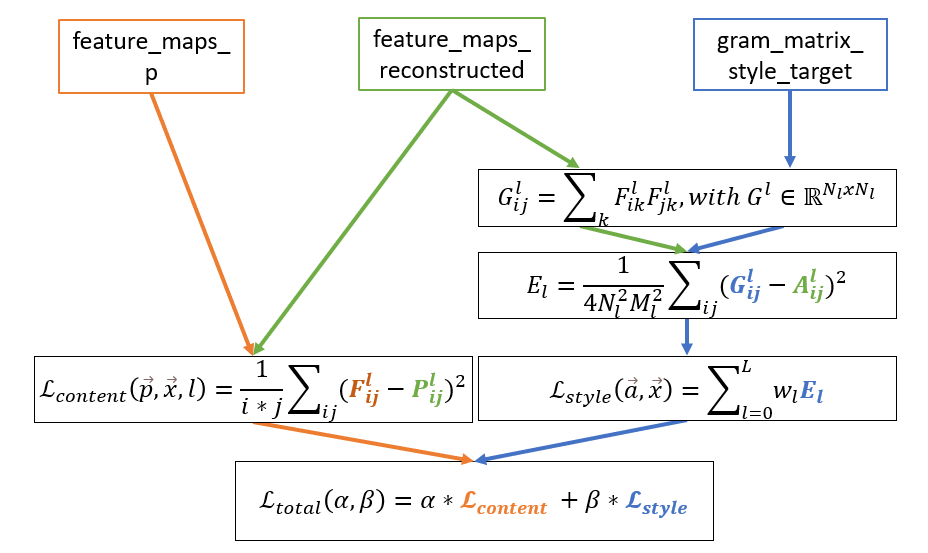

##Content Loss
This describes the difference between the context of two images, by directly comparing the feature maps (outputs of the prespecified intermediate layers) of two images after a network feed forward. Comparison is done by taking the element-wise MSE of feature maps of both images from the same predefined intermediate layer (e.g. block4_2 in the paper)



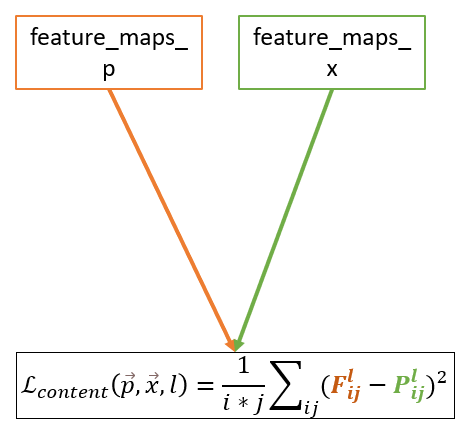

Formula used by Gatys et al. (2015):

$\mathcal{L}_{content}(\vec{p},\vec{x},l) =  \frac{1}{2}\sum_{ij}(F^l_{ij}-P^l_{ij})^2$, with $F^l,P^l\in \mathbb{R}^{N_l \times M_l}$, 
with $N_l$: filter count (equals count of feature maps), 

Formula used by us and Yuan (2018), since the results were better: 

$\mathcal{L}_{content}(\vec{p},\vec{x},l) =  \frac{1}{1*j}\sum_{ij}(F^l_{ij}-P^l_{ij})^2$, with $F^l,P^l\in \mathbb{R}^{N_l \times M_l}$, 
with $N_l$: filter count (equals count of feature maps),



$M_l$: the product of the height and width 

$\vec{p}$ is the content image and $\vec{x}$ is the reconstructed image

$F^l_{ij}$ is the the activation of the *i*-th filter at position *j* in layer *l* of the reconstructed image

$P^l_{ij}$ is the the activation of the *i*-th filter at position *j* in layer *l* of the content image


In [ ]:
def get_content_loss(feature_maps_p, feature_maps_x):
  """
  this function computes the layer-wise content loss 

  @params 
  feature_maps_p: The feature maps, that have been computed from the content image p 
  feature_maps_x: The feature maps, that have been computed from the intput image x 

  @return
  single float loss score
  """
  #taking the mean instead of summing up only creates more appealing results for us
  return tf.reduce_mean(tf.square(feature_maps_x - feature_maps_p)) 

##Style Loss

The style of two images are compared by comparing their corresponding style representation. The (layer-wise) style representation is realized by so called
Gram-matrices which contains the correlation score between all filters within a layer. The total style loss is computed across several (style) layers with each layer weighed individually. The difference in the style representation is calculated again by taking the MSE between the corresponding gram matrices.

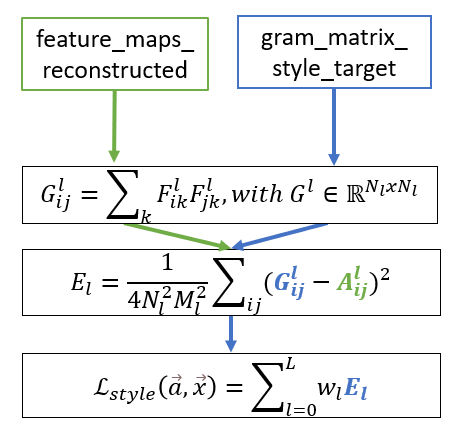


**Total style loss:** $\mathcal{L}_{style}(\vec{a},\vec{x})=\sum_{l=0}^{L}w_lE_l$

where $\vec{a}$ is the style image, $\vec{x}$ the reconstructed image, $E_l$ the squared distance term of the gram matrices (style representation) in layer $l$ with its respected weights $w_l$


**Weighted subterm:** $E_l=\frac{1}{4N^2_lM^2_l}\sum_{ij}(G^l_{ij}-A^l_{ij})^2$

where $N_l$ is the filter count (equals count of feature maps), $M_l$ the product of the height and width, $G^l_{ij}$ the gram matrice of the reconstructed image and $A^l_{ij}$ the gram matrice of the style image w.r.t. the layer $l$.
Yuan (2018) used this alternate formula for $E_l$:
$E_l=\frac{1}{i*j}\sum_{ij}(G^l_{ij}-A^l_{ij})^2$



**Gram-Matrices:** $G^l_{ij}=\sum_kF^l_{ik}F^l_{jk}$ 
,with $G^l\in \mathbb{R}^{N_l \times N_l}$

where $G^l_{ij}$ is the one entry of the matrix, describing the correlation between the feature maps of filter $i$ and $j$ in layer $l$. $G^l_{ij}$ is obtained by summing over all inner products between two vectorised feature maps $F^l_{ik}$ and $F^l_{jk}$ over all activations/pixels $k$


In [ ]:
def get_gramMatrix(feature_maps):
  """
  function to calculate the style representation given the feature maps

  @params
  feature_maps: 3-D [heigt, width, feature maps]

  @return
  a gram matrices with dimension [feature maps, feature maps]
  """
  #We make the image channels first 
  channels = int(feature_maps.shape[-1])
  #shape [height*width, feature_maps]
  tmp = tf.reshape(feature_maps, [-1, channels])
  #by transpose + multiplicating we get the correlation score for each feature maps tuple
  gram = tf.matmul(tmp,tmp, transpose_a=True)
  #we scale by height*width
  return gram / tf.cast(tf.shape(tmp)[0], tf.float32)

In [ ]:
def E_l(gram_matrix_style_target, feature_maps_reconstructed):
  """
  layer-wise weigted subterm function

  @params
  gram_matrix_style_target: precalculated gram matrix of target style
  feature_maps_reconstructed: feature maps of the reconstructed image (same layer as gram_matrix_style_target)

  @return
  single score representing the (layer-wise) style difference
  """
  squared_distance = tf.square(get_gramMatrix(feature_maps_reconstructed) - gram_matrix_style_target)
  #we used the mean again instead of only the sum and excluded the weighted term for more appealing results
  return tf.reduce_mean(squared_distance) #/ (4 * (feature_maps_reconstructed.shape[-1] ** 2) * ((feature_maps_reconstructed.shape[0] * feature_maps_reconstructed.shape[1])** 2))

In [ ]:
def get_style_loss(style_gram_matrices, feature_maps_reconstructed_all_layer, weights_per_style_layer):
  """
  function to calculate the total style loss

  @params
  style_gram_matrices: list of gram matrices for all intermediate target style layers
  feature_maps_reconstructed_all_layer: all reconstructed feature maps for alle intermediate reconstructed style layers
  weights_per_style_layer: vector of same length of prev. two param with respective weightings per layer

  @return
  total loss score accumlated over all style intermediate layers
  """
  loss = 0
  for i in range(len(style_gram_matrices)):
    loss += weights_per_style_layer[i] * E_l(style_gram_matrices[i], feature_maps_reconstructed_all_layer[i])
  return loss

##Total Loss

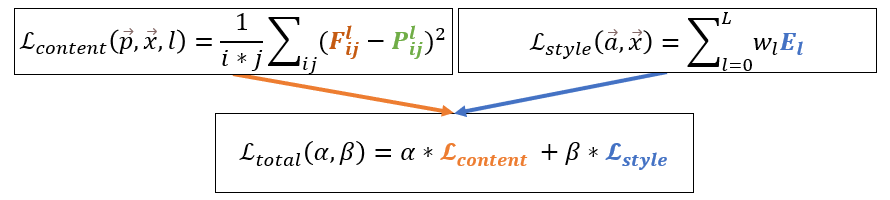

In [ ]:
def get_total_loss(style_gram_matrices, feature_maps_reconstructed_all_layer, feature_maps_content, feature_maps_reconstructed, style_content_weight):
  """
  over total loss function combining style and content loss

  @params
  style_gram_matrices: precomputed gram matrices of all style layers (from several layers)
  feature_maps_reconstructed_all_layer: all feature maps of the reconstructed image (to match the style)
  feature_maps_content: all content feature maps of the content image (from one layer)
  feature_maps_reconstructed: all content feature maps of the reconstructed image (to match the content)
  style_content_weight: tuple of weight to weight the overall style/content loss
  
  @return
  total overall loss score, style loss score, content loss score
  """
  #recommended style layer weights from https://github.com/leongatys/PytorchNeuralStyleTransfer/blob/master/NeuralStyleTransfer.ipynb
  weights_per_style_layer = [1e3/n**2 for n in [64,128,256,512,512]]
  #compute total style loss score
  style_score = get_style_loss(style_gram_matrices, feature_maps_reconstructed_all_layer, weights_per_style_layer)
  #compute total content loss score
  content_score = get_content_loss(feature_maps_content, feature_maps_reconstructed)
  #extract and weigh the total style/content scores
  content_weight, style_weight = style_content_weight
  style_score *= style_weight
  content_score *= content_weight
  total_loss = style_score + content_score
  return total_loss, style_score, content_score

# Optimization Loop

Defining the single train step function

In [ ]:
#determine clipping [0,255] values by imagenet means
norm_means = np.array([103.939, 116.779, 123.68])
min_vals = -norm_means
max_vals = 255 - norm_means

def train_step(model, 
               target_content_features, 
               style_gram_matrices, 
               reconstructed_image, 
               optimizer, 
               content_layer_num, 
               style_layers_num,
               content_weight,
               style_weight,
               avg_pool):
  """
  single train step function

  @params
  model: pretrained model (VGG19)
  target_content_features: target content feature maps (from one preselected content intermediate layer)
  style_gram_matrices: target style gram matrices (from several preselected style intermediate layers)
  reconstructed image: reconstructed image to optimize
  optimizer: optimizer
  content_layer_num: int number determining the choosen content intermediate layer
  style_layers_num: int number determining the coosen style intermediate layers
  content_weight: overall content loss weight
  style_weight: over all style loss weight 
  avg_pool: boolean; whether AvgPooling should be performed instead of MaxPooling

  @return
  total loss, style loss, content loss
  """
  with tf.GradientTape() as tape:
    #reconstructed feed forward
    reconstructed_outputs = model(x = reconstructed_image, avg_pool = avg_pool, out_keys = style_layers + content_layer)
    #get reconstructed content feature maps
    reconstructed_content_features = [content_layer[0] for content_layer 
                             in reconstructed_outputs[content_layer_num - 1 : content_layer_num]]
    #get reconstructed style feature maps
    reconstructed_style_features = [style_layer[0] for style_layer 
                            in reconstructed_outputs[:style_layers_num]]
    #calculate losses                       
    total_loss, style_loss, content_loss = get_total_loss(style_gram_matrices, 
                                                          reconstructed_style_features, 
                                                          target_content_features[0], 
                                                          reconstructed_content_features[0], 
                                                          (content_weight,style_weight))
    #calculate gradients
    gradients = tape.gradient(total_loss, reconstructed_image)
  
  #optimize reconstructed image
  optimizer.apply_gradients([(gradients,reconstructed_image)])
  #clip reconstructed image values to valid range
  clipped = tf.clip_by_value(reconstructed_image, min_vals, max_vals)
  reconstructed_image.assign(clipped)
  return total_loss, style_loss, content_loss 
   

#Progress Visuzalizations

In [ ]:
def show_tripplet(result,content,style,figsize=(10,10), titles=True):
  """
  function to plot reconstructed image, content image and style image at the same time

  @params
  result: current state of the reconstructed image
  content: content image
  style: style image
  figsize: figure size of each subplot

  @return
  none
  """
  fig = plt.figure(figsize=figsize)
  ax1 = fig.add_subplot(131)
  plt.imshow(reverse_preprocess(result))
  plt.axis('off')
  ax2 = fig.add_subplot(132)
  plt.imshow(reverse_preprocess(content))
  plt.axis('off')
  ax3 = fig.add_subplot(133)
  plt.imshow(reverse_preprocess(style))
  plt.axis('off')
  if titles:
    ax1.title.set_text('Result')
    ax2.title.set_text('Content-Image')
    ax3.title.set_text('Style-Image')
  plt.show()


In [ ]:
def img_selection(timestamp,pics,content_image,style_image):
    """
    A function to visualize the image-tripplet (see "show_tripplet()") at a certain iteration, defined by timestamp. The Image that has been created at that iteration, is returned.

    @params
    timestamp: timestamp (iteration)
    pics: a list with every tenth image that has been reconstructed.
    content_image: content image
    style_image: style image

    @return
    pics[idx]: the image that has been reconstructed at the iteration defined by timestamp.
    """
    print("In timestamp", timestamp,"the result looked as followed:")
    idx=(timestamp)//10  #timestamp 0-->idx 0  timestamp 100-->idx 100
    show_tripplet(pics[idx],content_image,style_image,figsize=(20,20))

    return pics[idx]


#Loop

In [ ]:
#saving images in between for final vizualisation
pics=[]

#instantiate our model
opt_model = VGG19_Model()


def optimize(content_path, 
             style_path,
             num_iterations,
             content_layer_num,
             style_layers_num,
             content_weight,
             style_weight,
             learning_rate,
             avg_pool,
             randomized,
             show_results=True):
  """
  training step abstraction function (calling the training step function)

  @params
  content_path: path of the content image
  style_path: path of the style image
  num_iterations: iterations of training
  content_layer_num: int number determining the choosen content intermediate layer
  style_layers_num: int number determining the coosen style intermediate layers
  content_weight: overall content loss weight
  style_weight: over all style loss weight 
  learning_rate: learning for the optimizer
  avg_pool: boolean; MaxPooling or AvgPooling
  randomized: boolean; starting with a noise image or the content image itselves
  show_results: boolean; showing the reconstructed image at the end.

  @return
  pics: list of images showing the progress of optimization (for slide show)
  t[0]: the best image after optimization
  """
  tf.keras.backend.clear_session()
  #Load and preprocess content and style image
  img = Image.open(content_path)
  content_image = preprocess_image(img, vgg19=True)
  img = Image.open(style_path)
  style_image = preprocess_image(img, vgg19=True)
  #Add Batch dim
  content_image = tf.expand_dims(content_image, axis=0)
  style_image = tf.expand_dims(style_image, axis=0)

  #Initialize reconstructed image (white noise image) 
  reconstructed_image = tf.random.uniform([512, 512, 3], 0, 255, dtype=tf.dtypes.float32)
  #Add Batch dim
  reconstructed_image = tf.expand_dims(reconstructed_image, axis = 0)
  if not randomized:
    reconstructed_image = content_image
  reconstructed_image = tf.Variable(reconstructed_image, dtype=tf.dtypes.float32)

  #forward pass of style and content image
  model = opt_model 
  #compute the content feature maps
  content_outputs = model(x = content_image, avg_pool = avg_pool, out_keys = style_layers + content_layer)
  content_features =  [content_layer[0] for content_layer 
                      in content_outputs[content_layer_num - 1 : content_layer_num]] 
  #compute the style feature maps/gram matrices
  style_outputs = model(x = style_image, avg_pool = avg_pool, out_keys = style_layers + content_layer)
  style_features = [style_layer[0] for style_layer 
                    in style_outputs[:style_layers_num]]
  style_gram_matrices = [get_gramMatrix(layer) for layer in style_features]

  #set Opimizer
  optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=0.99, epsilon=1e-1)

  #Initialize Progress Bar
  with tqdm(total=num_iterations, bar_format="{l_bar}{bar}   {n_fmt}/{total_fmt}  {elapsed}<{remaining}   {postfix[0]}{postfix[1][value]}   {postfix[2]}{postfix[3][value]}   {postfix[4]}{postfix[5][value]}",
            postfix=["Total Loss:", dict(value=0),"Style Loss:", dict(value=0),"Content Loss:", dict(value=0)]) as progressbar:

    for iteration in range(num_iterations):
      #calling the training step function
      total_loss, style_loss, content_loss = train_step(model, 
                                                        content_features, 
                                                        style_gram_matrices, 
                                                        reconstructed_image, 
                                                        optimizer,
                                                        content_layer_num,
                                                        style_layers_num,
                                                        content_weight,
                                                        style_weight,
                                                        avg_pool)
      #record the best image, best loss
      if iteration == 0:
        best_loss = total_loss
        best_image = None
      else:
        if total_loss < best_loss:
          best_loss = total_loss
          best_image = reconstructed_image

      #save progress image each 10 iterations for slide show
      if iteration % 10 == 0:
        #in iteration 0 the best image is set to None. Since None is not an image, we want to avoid problems with the visualization. 
        if not(type(best_image)==type(None)):
          t = best_image
          #take image without batch dim
          pics.append(t[0])
        else:
          pics.append(preprocess_image(Image.open(content_path), vgg19=True))
      if iteration % 100 == 0 and iteration != 0:
        t = best_image
        #show_tripplet(t[0],content_image[0],style_image[0],figsize=(16,16))

      #Progress Bar
      progressbar.postfix[1]["value"] = best_loss
      progressbar.postfix[3]["value"] = style_loss
      progressbar.postfix[5]["value"] = content_loss
      progressbar.update()

    if show_results:
      show_tripplet(t[0],content_image[0],style_image[0],figsize=(16,16))

    return pics, t[0]



#Download Reconstructed Image

After selecting an Image below you can download it directly to your computer.

In [ ]:
def download_image(img, img_name, preview = False):
  """
  function to download an image

  @params
  img: image
  img_name: file name for the image

  @return
  none
  """
  img_dir = '/content/img/'
  if not os.path.exists(img_dir):
    os.makedirs(img_dir)
  #n_dim(img) == 3  
  img = reverse_preprocess(img)
  img = img.numpy()
  img = img * 255
  img = img.astype(np.uint8)
  if preview:
    imshow(img, dtype=tf.dtypes.uint8)
  img_data=Image.fromarray(img, 'RGB')
  img_data.save(str(img_dir)+str(img_name))
  FILE.download(str(img_dir)+str(img_name))

100%|██████████   500/500  01:11<00:00   Total Loss:93345.9140625   Style Loss:27275.4296875   Content Loss:66070.484375

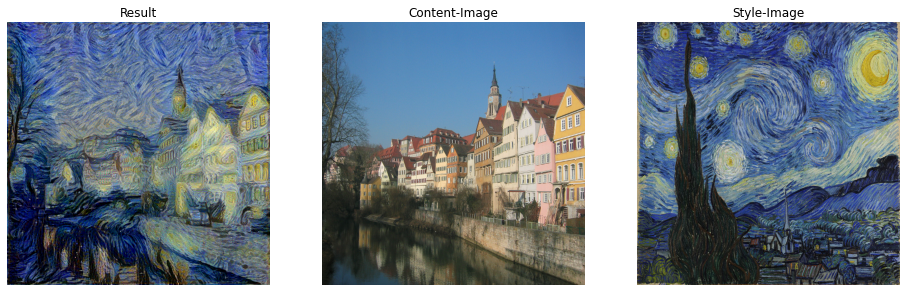

100%|██████████   500/500  01:12<00:00   Total Loss:93345.9140625   Style Loss:27275.4296875   Content Loss:66070.484375


In [ ]:
#These Parameters have been identified by us in the section about variation. Feel free to change them.
content_weight = 1e0 #@param
style_weight = 2e0 #@param
num_iterations=500 #@param
style_layers_num = 5 #@param



pics, best_image =optimize(content_path = content_path, 
        style_path = style_path,
        num_iterations = num_iterations, 
        content_layer_num = 6, #which layer of content
        style_layers_num = style_layers_num, #how many style layers
        content_weight = content_weight,
        style_weight = style_weight,
        learning_rate = 2.5,
        avg_pool = True,
        randomized = False,
        show_results = True)
    

In [ ]:
content_image = preprocess_image(Image.open(content_path), vgg19=True)
style_image = preprocess_image(Image.open(style_path), vgg19=True)

intrct=interactive(img_selection, timestamp=(0,num_iterations-1,10), pics=fixed(pics),content_image=fixed(content_image),style_image=fixed(style_image),loss_list=fixed(None), layout=Layout(width='80%'))

output = intrct.children[-1]
output.layout.height = '350px'

display(intrct)

interactive(children=(IntSlider(value=240, description='timestamp', max=499, step=10), Output(layout=Layout(he…

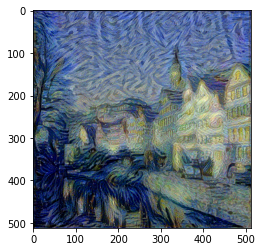

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
name="Filename"#@param
file_extension=".jpg" #@param[".png", ".jpg"]
download_image(intrct.result.numpy(),name+file_extension, preview=True)

# Variations
There are many hyper-parameters which can be fine-tuned. Here we present some variations the results from it. Feel free to play around, if you have additional ideas. If you want to change the chosen intermediate layers, feel free to change them in the "Build Model" section.

##Variation: Different Initalization

100%|██████████   500/500  01:20<00:00   Total Loss:24896016.0   Style Loss:24207866.0   Content Loss:688149.25
100%|██████████   500/500  01:21<00:00   Total Loss:1103431.0   Style Loss:583599.4375   Content Loss:519831.5625


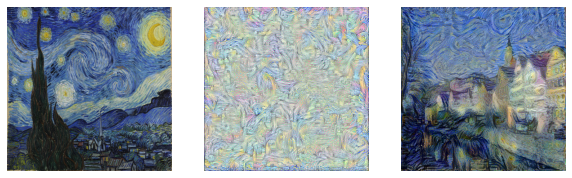

100%|██████████   500/500  01:21<00:00   Total Loss:19824846.0   Style Loss:19015716.0   Content Loss:809129.1875
100%|██████████   500/500  01:21<00:00   Total Loss:6739059.0   Style Loss:6146874.5   Content Loss:592184.625


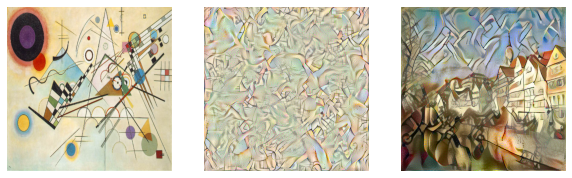

100%|██████████   500/500  01:22<00:00   Total Loss:49359524.0   Style Loss:48786144.0   Content Loss:573378.5
100%|██████████   500/500  01:22<00:00   Total Loss:2155060.25   Style Loss:1709431.5   Content Loss:445628.75


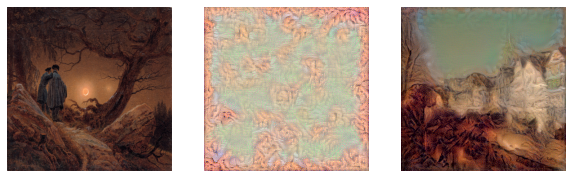

In [ ]:
content_weight = 1e0 
style_weight = 2e0 

on_off=[True, False]
paths=['/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg','/tmp/nst/Vassily_Kandinsky,_1923_-_Composition_8,_huile_sur_toile,_140_cm_x_201_cm,_Musée_Guggenheim,_New_York.jpg', '/tmp/nst/1024px-Caspar_David_Friedrich_-_Zwei_Männer_in_Betrachtung_des_Mondes.jpg']
for path in paths:
  best_images=[]
  for i in on_off:
    pics, best_image =optimize(content_path = content_path, 
            style_path = path,
            num_iterations = 500, 
            content_layer_num = 6, #which layer of content
            style_layers_num = 5, #how many style layers
            content_weight = content_weight,
            style_weight = style_weight,
            learning_rate = 2.5,
            avg_pool = False,
            randomized =i,
            show_results=False)
    best_images.append(best_image)
  show_tripplet(preprocess_image(Image.open(path), vgg19=True), best_images[0],best_images[1], titles=False)
    

##Variation: Average-Pooling vs. Max-Pooling

100%|██████████   500/500  01:16<00:00   Total Loss:93357.296875   Style Loss:27291.20703125   Content Loss:66066.09375

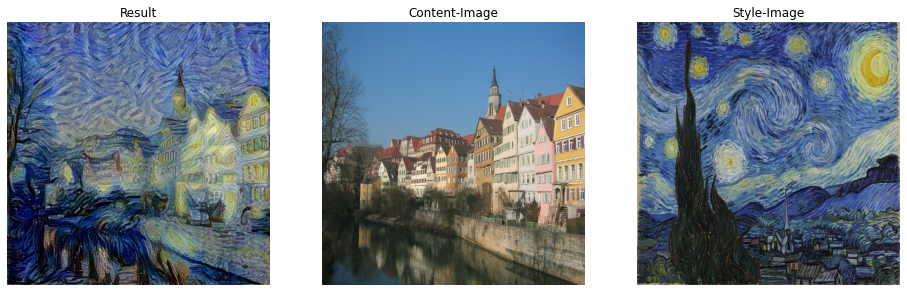

100%|██████████   500/500  01:16<00:00   Total Loss:93357.296875   Style Loss:27291.20703125   Content Loss:66066.09375
100%|██████████   500/500  01:22<00:00   Total Loss:1103211.75   Style Loss:583177.0625   Content Loss:520034.75   

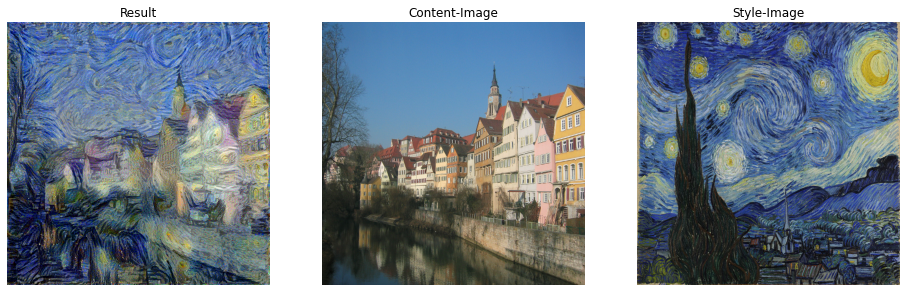

100%|██████████   500/500  01:22<00:00   Total Loss:1103211.75   Style Loss:583177.0625   Content Loss:520034.75


In [ ]:
content_weight = 1e0 
style_weight = 2e0 

on_off=[True, False]
for i in on_off:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = i,
          randomized =False)

100%|██████████   500/500  01:16<00:00   Total Loss:160363.8125   Style Loss:81687.3203125   Content Loss:78676.484375

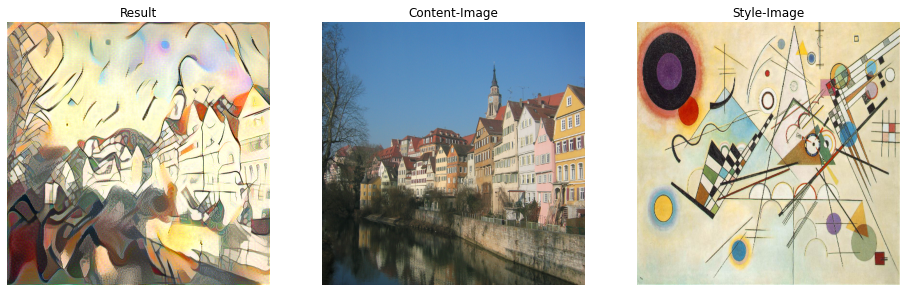

100%|██████████   500/500  01:16<00:00   Total Loss:160363.8125   Style Loss:81687.3203125   Content Loss:78676.484375
100%|██████████   500/500  01:22<00:00   Total Loss:6754085.5   Style Loss:6161897.0   Content Loss:592188.6875

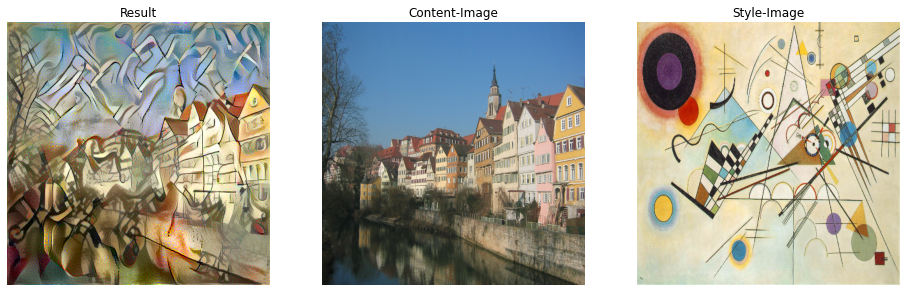

100%|██████████   500/500  01:22<00:00   Total Loss:6754085.5   Style Loss:6161897.0   Content Loss:592188.6875


In [ ]:
content_weight = 1e0 
style_weight = 2e0 

on_off=[True, False]
for i in on_off:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/Vassily_Kandinsky,_1923_-_Composition_8,_huile_sur_toile,_140_cm_x_201_cm,_Musée_Guggenheim,_New_York.jpg',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = i,
          randomized =False)

100%|██████████   500/500  01:16<00:00   Total Loss:102740.3125   Style Loss:40633.8984375   Content Loss:62106.4140625   

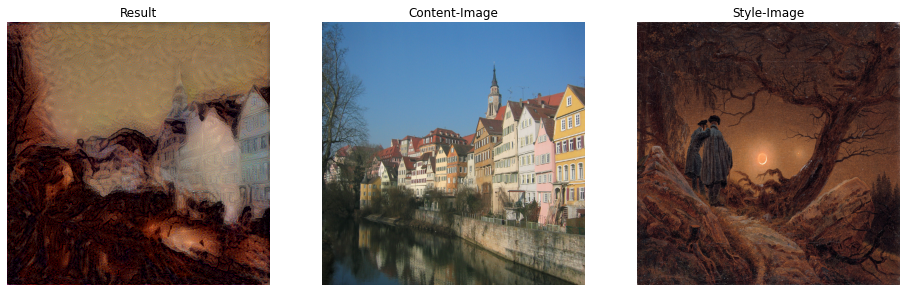

100%|██████████   500/500  01:16<00:00   Total Loss:102740.3125   Style Loss:40633.8984375   Content Loss:62106.4140625
100%|██████████   500/500  01:22<00:00   Total Loss:2156125.75   Style Loss:1710057.75   Content Loss:446068.0625  

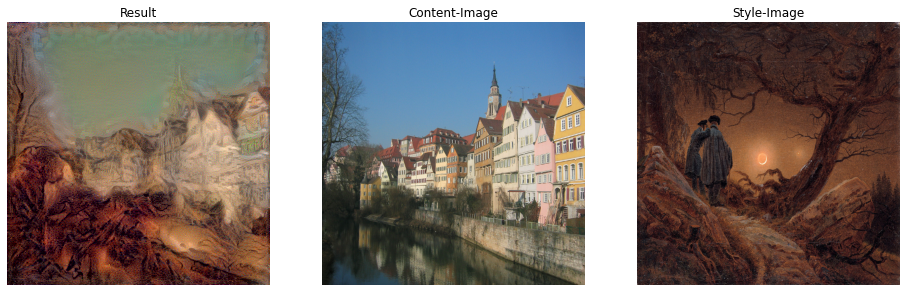

100%|██████████   500/500  01:22<00:00   Total Loss:2156125.75   Style Loss:1710057.75   Content Loss:446068.0625


In [ ]:
content_weight = 1e0 
style_weight = 2e0 

on_off=[True, False]
for i in on_off:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Caspar_David_Friedrich_-_Zwei_Männer_in_Betrachtung_des_Mondes.jpg.1',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = i,
          randomized =False)

##Variation: Different style weights


 Style weight: 0.002


100%|██████████   500/500  01:16<00:00   Total Loss:14357.1279296875   Style Loss:10708.3154296875   Content Loss:3648.812744140625

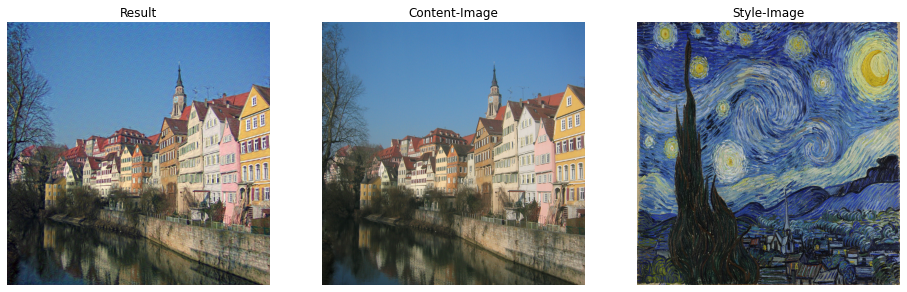

100%|██████████   500/500  01:16<00:00   Total Loss:14357.1279296875   Style Loss:10708.3154296875   Content Loss:3648.812744140625



 Style weight: 0.02


100%|██████████   500/500  01:16<00:00   Total Loss:34652.0703125   Style Loss:9748.14453125   Content Loss:24903.927734375

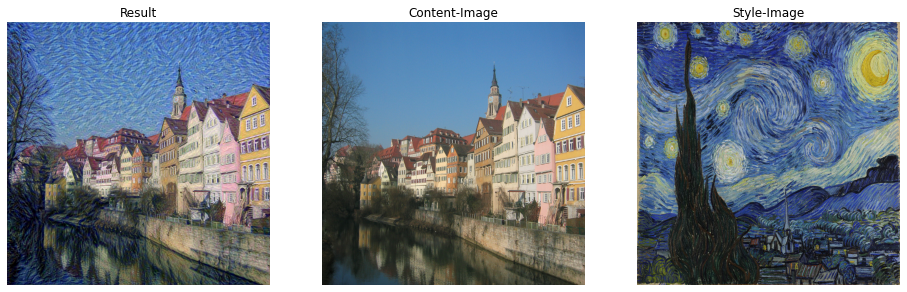

100%|██████████   500/500  01:16<00:00   Total Loss:34652.0703125   Style Loss:9748.14453125   Content Loss:24903.927734375



 Style weight: 0.2


100%|██████████   500/500  01:16<00:00   Total Loss:54957.9296875   Style Loss:11310.4951171875   Content Loss:43647.43359375

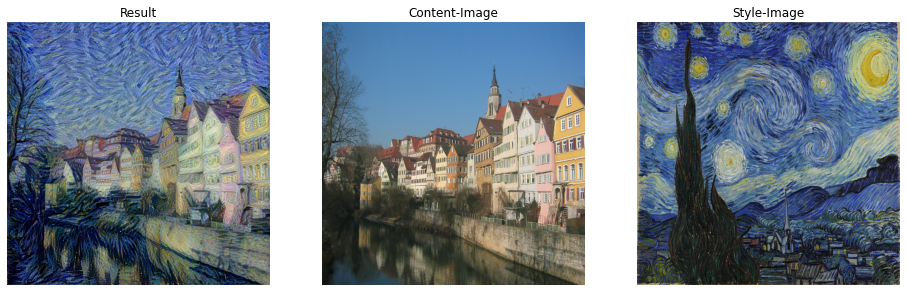

100%|██████████   500/500  01:16<00:00   Total Loss:54957.9296875   Style Loss:11310.4951171875   Content Loss:43647.43359375



 Style weight: 2.0


100%|██████████   500/500  01:16<00:00   Total Loss:93370.3515625   Style Loss:27301.658203125   Content Loss:66068.6953125

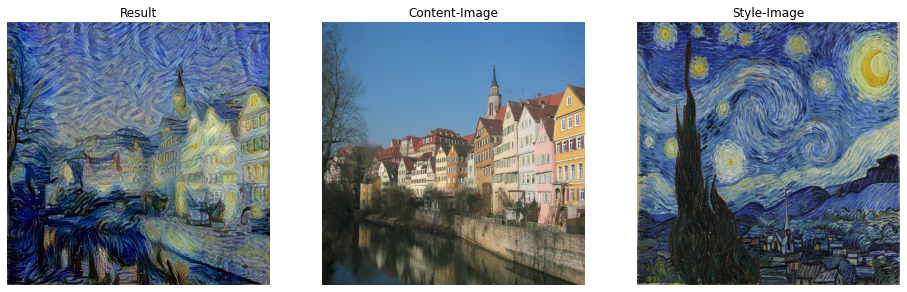

100%|██████████   500/500  01:16<00:00   Total Loss:93370.3515625   Style Loss:27301.658203125   Content Loss:66068.6953125


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
content_weight = 1e0
style_weights = [2e-3, 2e-2, 2e-1, 2e0]
pics=[]
best_images = []
for s_weight in style_weights:
  print("\n Style weight: " + str(s_weight))
  pics, best_image = optimize(content_path = content_path, 
          style_path = style_path,
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = s_weight,
          learning_rate = 2.5,
          avg_pool = True, 
          randomized = False)
  best_images.append(best_image)
  
file_names = ["tuebingen_vangogh_styleweights_2e-3.jpg",
              "tuebingen_vangogh_styleweights_2e-2.jpg",
              "tuebingen_vangogh_styleweights_2e-1.jpg",
              "tuebingen_vangogh_styleweights_2e-0.jpg"]

for img, file_name in zip(best_images, file_names):
  download_image(img, file_name)
            

##Variation: Different style images


 Path: /tmp/nst/Vassily_Kandinsky,_1913_-_Composition_7.jpg


100%|██████████   500/500  01:16<00:00   Total Loss:275233.40625   Style Loss:150477.46875   Content Loss:124755.9453125

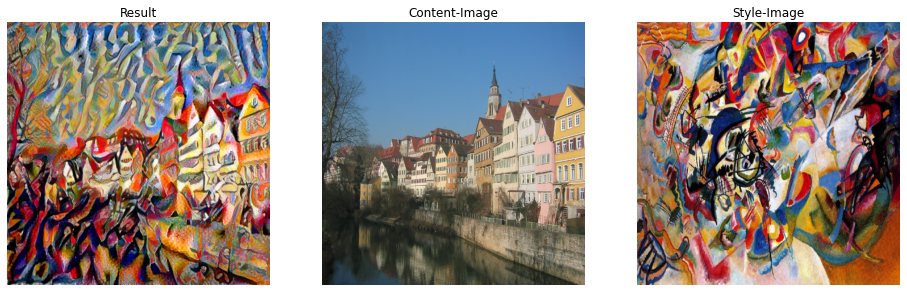

100%|██████████   500/500  01:16<00:00   Total Loss:275233.40625   Style Loss:150477.46875   Content Loss:124755.9453125



 Path: /tmp/nst/The_Great_Wave_off_Kanagawa.jpg


100%|██████████   500/500  01:16<00:00   Total Loss:351504.96875   Style Loss:274040.0   Content Loss:77464.9609375  

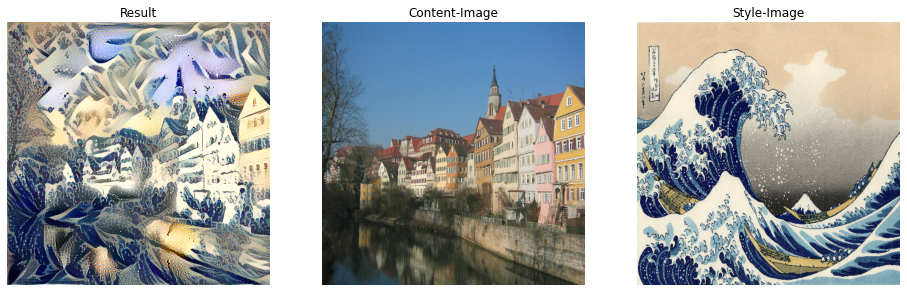

100%|██████████   500/500  01:17<00:00   Total Loss:351504.96875   Style Loss:274040.0   Content Loss:77464.9609375


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
content_weight = 1e0 
style_weight = 2e0 

style_paths = ['/tmp/nst/Vassily_Kandinsky,_1913_-_Composition_7.jpg',
               '/tmp/nst/The_Great_Wave_off_Kanagawa.jpg']
best_images = []
for path in style_paths:
  print("\n Path: " + str(path))
  pics, best_image=optimize(content_path = content_path, 
          style_path = path,
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = True,
          randomized = False)
  best_images.append(best_image)

file_names = ["tuebingen_kardinsky_styleimage.jpg",
              "tuebingen_kanagawa_styleimage.jpg"]

for img, file_name in zip(best_images, file_names):
  download_image(img, file_name)


##Variation: Increasing style layers


 Style Layers: ['block1_conv1']


100%|██████████   500/500  01:02<00:00   Total Loss:9063.330078125   Style Loss:1785.51611328125   Content Loss:7277.814453125

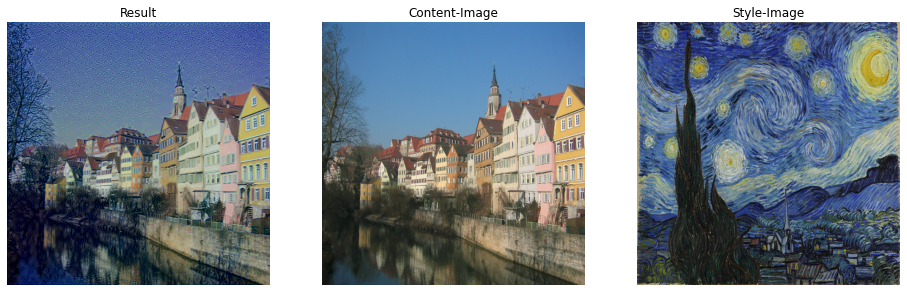

100%|██████████   500/500  01:03<00:00   Total Loss:9063.330078125   Style Loss:1785.51611328125   Content Loss:7277.814453125



 Style Layers: ['block1_conv1', 'block2_conv1']


100%|██████████   500/500  01:04<00:00   Total Loss:37173.9453125   Style Loss:15060.5478515625   Content Loss:24644.869140625

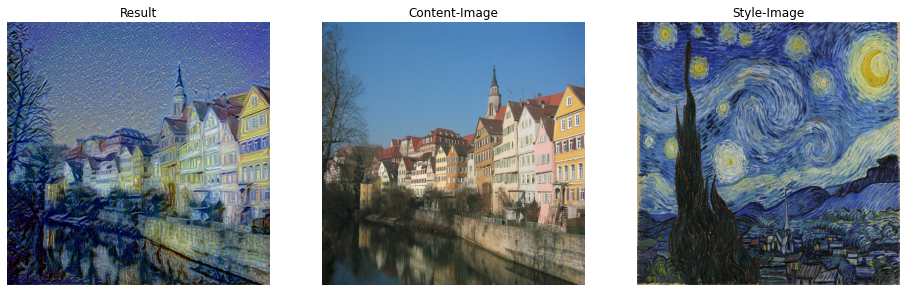

100%|██████████   500/500  01:05<00:00   Total Loss:37173.9453125   Style Loss:15060.5478515625   Content Loss:24644.869140625



 Style Layers: ['block1_conv1', 'block2_conv1', 'block3_conv1']


100%|██████████   500/500  01:06<00:00   Total Loss:49441.046875   Style Loss:15419.96875   Content Loss:34021.078125      

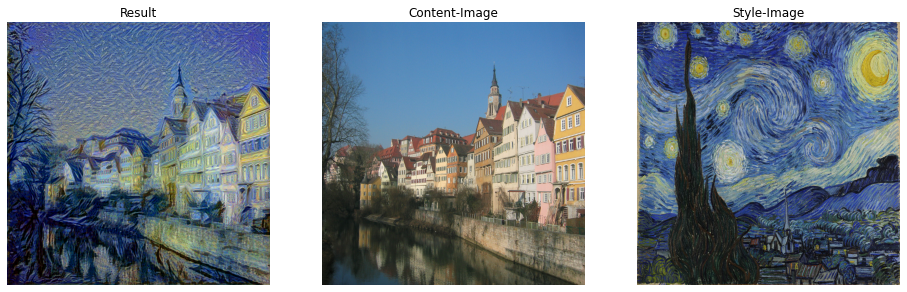

100%|██████████   500/500  01:06<00:00   Total Loss:49441.046875   Style Loss:15419.96875   Content Loss:34021.078125



 Style Layers: ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']


100%|██████████   500/500  01:07<00:00   Total Loss:93273.234375   Style Loss:27201.51953125   Content Loss:66071.71875

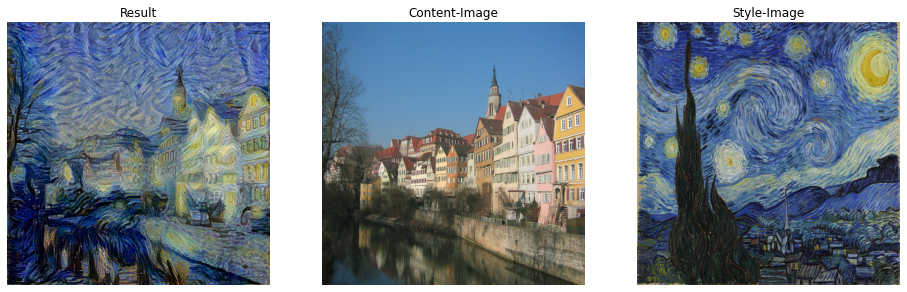

100%|██████████   500/500  01:08<00:00   Total Loss:93273.234375   Style Loss:27201.51953125   Content Loss:66071.71875



 Style Layers: ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']


100%|██████████   500/500  01:16<00:00   Total Loss:93330.734375   Style Loss:27268.634765625   Content Loss:66062.1015625

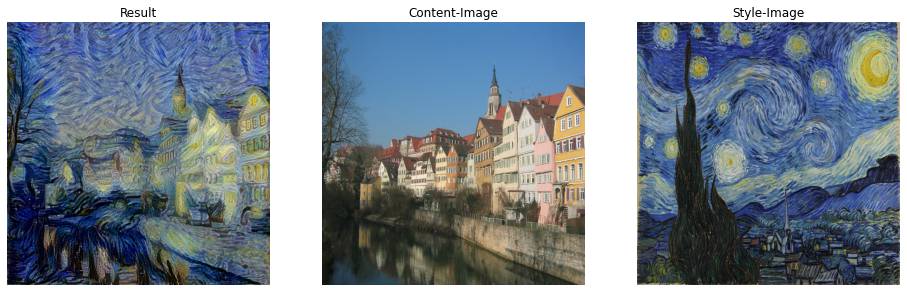

100%|██████████   500/500  01:17<00:00   Total Loss:93330.734375   Style Loss:27268.634765625   Content Loss:66062.1015625


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
content_weight = 1e0 
style_weight = 2e0

pics=[]
best_images = []
for i in range(5):
  print("\n Style Layers: " + str(style_layers[:i+1]))
  pics, best_image =optimize(content_path = content_path, 
          style_path = style_path,
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = i+1, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = True,
          randomized = False)
  best_images.append(best_image)
  
file_names = ["tuebingen_vangogh_stylelayers_1.jpg",
              "tuebingen_vangogh_stylelayers_2.jpg",
              "tuebingen_vangogh_stylelayers_3.jpg",
              "tuebingen_vangogh_stylelayers_4.jpg",
              "tuebingen_vangogh_stylelayers_5.jpg"]

for img, file_name in zip(best_images, file_names):
  download_image(img, file_name)

##Variation: Increasing Style Layers with noise image


 Style Layers: ['block1_conv1']


100%|██████████   500/500  01:00<00:00   Total Loss:2618.794921875   Style Loss:2618.794921875   Content Loss:0.0

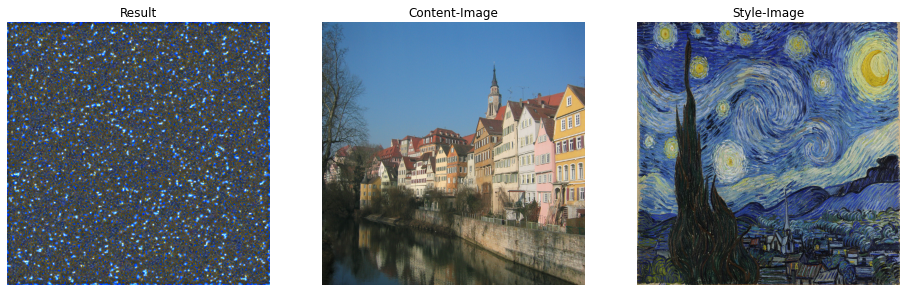

100%|██████████   500/500  01:00<00:00   Total Loss:2618.794921875   Style Loss:2618.794921875   Content Loss:0.0



 Style Layers: ['block1_conv1', 'block2_conv1']


100%|██████████   500/500  01:03<00:00   Total Loss:1060.6427001953125   Style Loss:1060.6427001953125   Content Loss:0.0

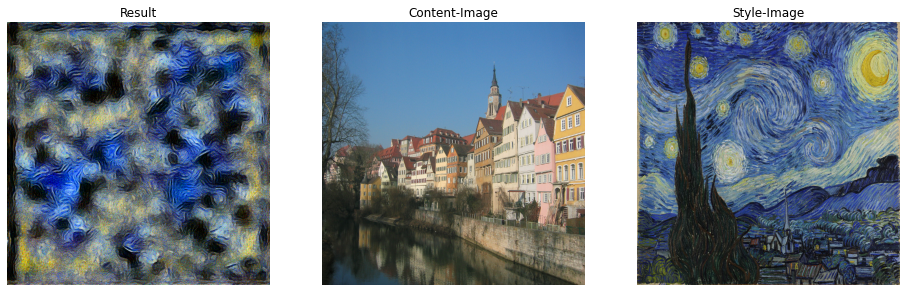

100%|██████████   500/500  01:03<00:00   Total Loss:1060.6427001953125   Style Loss:1060.6427001953125   Content Loss:0.0



 Style Layers: ['block1_conv1', 'block2_conv1', 'block3_conv1']


100%|██████████   500/500  01:05<00:00   Total Loss:2153.39892578125   Style Loss:2153.39892578125   Content Loss:0.0

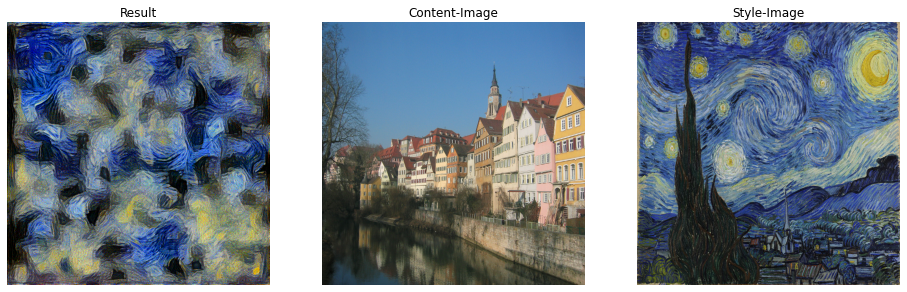

100%|██████████   500/500  01:05<00:00   Total Loss:2153.39892578125   Style Loss:2153.39892578125   Content Loss:0.0



 Style Layers: ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']


100%|██████████   500/500  01:07<00:00   Total Loss:15606.537109375   Style Loss:15606.537109375   Content Loss:0.0  

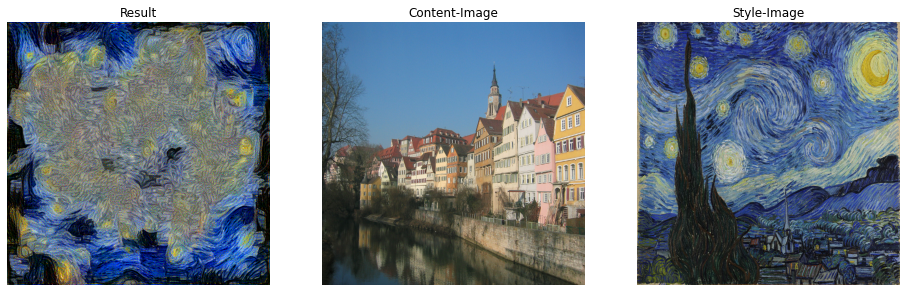

100%|██████████   500/500  01:08<00:00   Total Loss:15606.537109375   Style Loss:15606.537109375   Content Loss:0.0



 Style Layers: ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']


100%|██████████   500/500  01:16<00:00   Total Loss:16246.7294921875   Style Loss:16246.7294921875   Content Loss:0.0

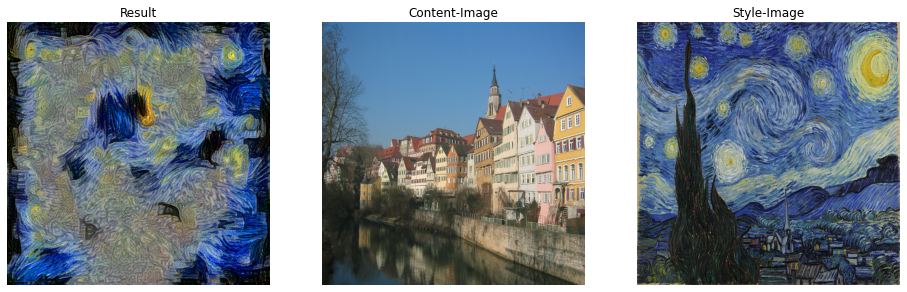

100%|██████████   500/500  01:17<00:00   Total Loss:16246.7294921875   Style Loss:16246.7294921875   Content Loss:0.0


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
content_weight = 0 
style_weight = 1e0

pics=[]
best_images = []
for i in range(5):
  print("\n Style Layers: " + str(style_layers[:i+1]))
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = i+1, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 50,
          avg_pool = True,
          randomized = True)
  best_images.append(best_image)
  
file_names = ["noiseImg_vangogh_stylelayers_1.jpg",
              "noiseImg_vangogh_stylelayers_2.jpg",
              "noiseImg_vangogh_stylelayers_3.jpg",
              "noiseImg_vangogh_stylelayers_4.jpg",
              "noiseImg_vangogh_stylelayers_5.jpg"]

for img, file_name in zip(best_images, file_names):
  download_image(img, file_name)

##Variation: Increasing Content Layers with noise image


 Content Layer: block1_conv1


100%|██████████   1000/1000  02:27<00:00   Total Loss:20.32062530517578   Style Loss:0.0   Content Loss:20.32062530517578

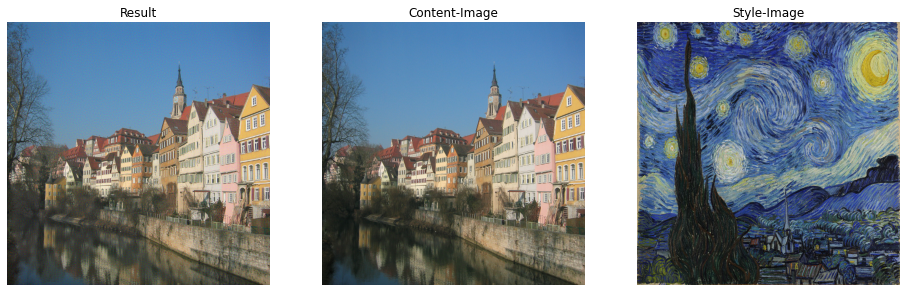

100%|██████████   1000/1000  02:27<00:00   Total Loss:20.32062530517578   Style Loss:0.0   Content Loss:20.32062530517578



 Content Layer: block2_conv1


100%|██████████   1000/1000  02:26<00:00   Total Loss:53.95430374145508   Style Loss:0.0   Content Loss:53.95430374145508

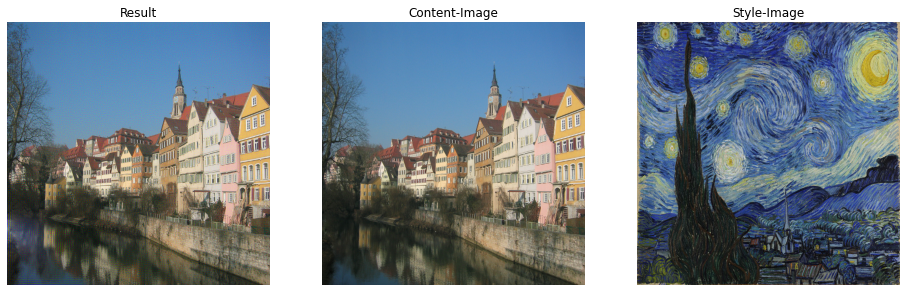

100%|██████████   1000/1000  02:27<00:00   Total Loss:53.95430374145508   Style Loss:0.0   Content Loss:53.95430374145508



 Content Layer: block3_conv1


100%|██████████   1000/1000  02:27<00:00   Total Loss:82.65933227539062   Style Loss:0.0   Content Loss:82.65933227539062

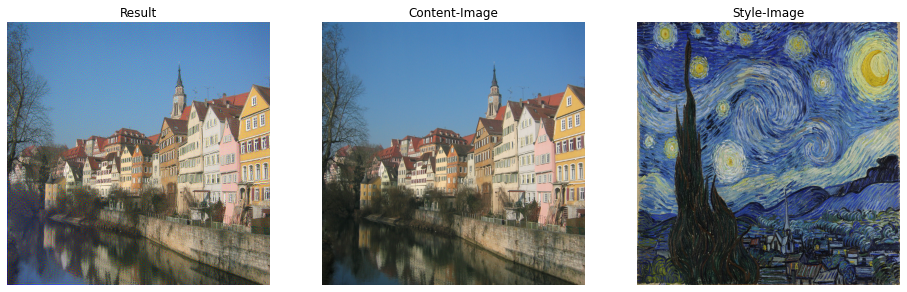

100%|██████████   1000/1000  02:28<00:00   Total Loss:82.65933227539062   Style Loss:0.0   Content Loss:82.65933227539062



 Content Layer: block4_conv1


100%|██████████   1000/1000  02:30<00:00   Total Loss:601.4347534179688   Style Loss:0.0   Content Loss:601.4347534179688

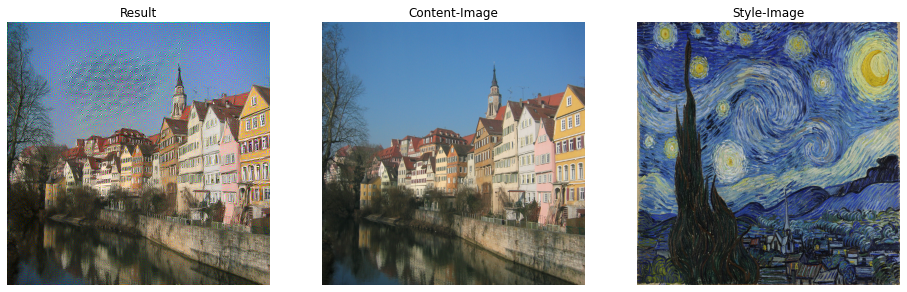

100%|██████████   1000/1000  02:30<00:00   Total Loss:601.4347534179688   Style Loss:0.0   Content Loss:601.4347534179688



 Content Layer: block5_conv1


100%|██████████   1000/1000  02:32<00:00   Total Loss:51.833702087402344   Style Loss:0.0   Content Loss:51.833702087402344

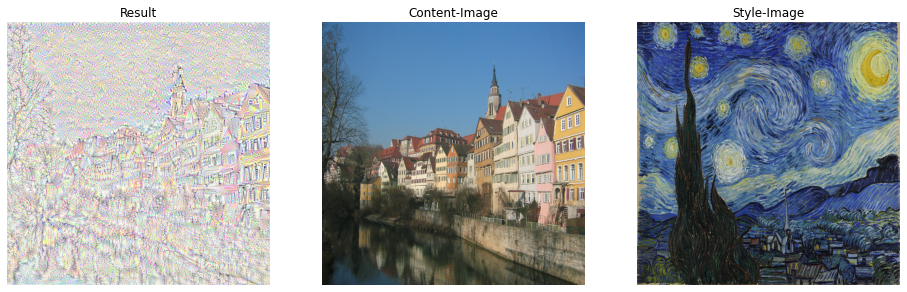

100%|██████████   1000/1000  02:33<00:00   Total Loss:51.833702087402344   Style Loss:0.0   Content Loss:51.833702087402344


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
content_weight = 1e0 
style_weight = 0

pics=[]
best_images = []
for i in range(5):
  print("\n Content Layer: " + str(style_layers[i]))
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg',
          num_iterations = 1000, 
          content_layer_num = i+1, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 1000, #High learning rate, to achieve a fast convergence towards the original pixel values.
          avg_pool = True,
          randomized = True)
  best_images.append(best_image)
  
file_names = ["noiseImg_vangogh_contentlayers_1.jpg",
              "noiseImg_vangogh_contentlayers_2.jpg",
              "noiseImg_vangogh_contentlayers_3.jpg",
              "noiseImg_vangogh_contentlayers_4.jpg",
              "noiseImg_vangogh_contentlayers_5.jpg"]

for img, file_name in zip(best_images, file_names):
  download_image(img, file_name)

##Variation: Different number of iterations

100%|██████████   50/50  00:08<00:00   Total Loss:30066508.0   Style Loss:29643652.0   Content Loss:422855.84375

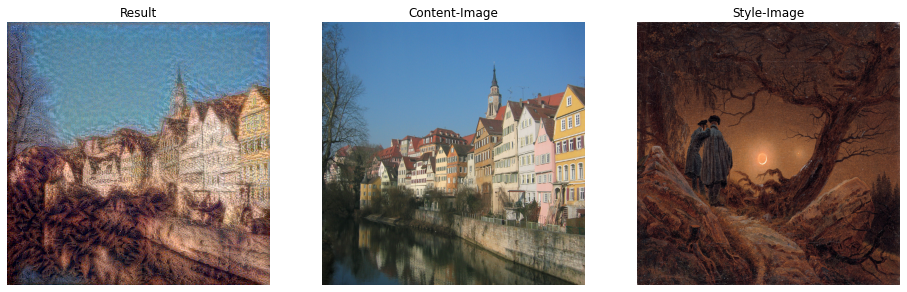

100%|██████████   50/50  00:08<00:00   Total Loss:30066508.0   Style Loss:29643652.0   Content Loss:422855.84375
100%|██████████   100/100  00:16<00:00   Total Loss:13024962.0   Style Loss:12589839.0   Content Loss:435123.1875

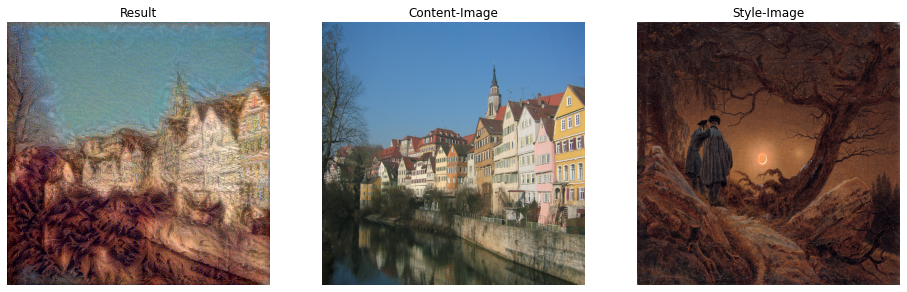

100%|██████████   100/100  00:16<00:00   Total Loss:13024962.0   Style Loss:12589839.0   Content Loss:435123.1875
100%|██████████   250/250  00:41<00:00   Total Loss:4241723.5   Style Loss:3788051.75   Content Loss:453671.625

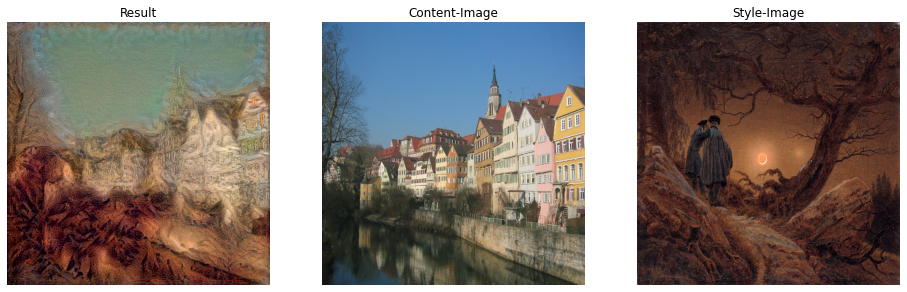

100%|██████████   250/250  00:41<00:00   Total Loss:4241723.5   Style Loss:3788051.75   Content Loss:453671.625
100%|██████████   500/500  01:22<00:00   Total Loss:2154740.75   Style Loss:1708932.625   Content Loss:445808.15625

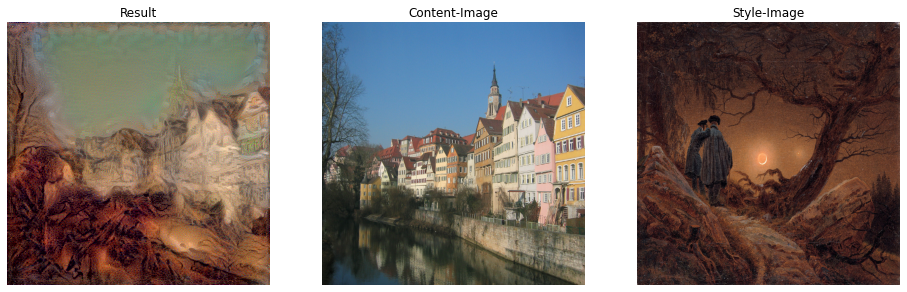

100%|██████████   500/500  01:22<00:00   Total Loss:2154740.75   Style Loss:1708932.625   Content Loss:445808.15625
100%|██████████   1000/1000  02:43<00:00   Total Loss:1152644.25   Style Loss:752407.5625   Content Loss:400236.71875

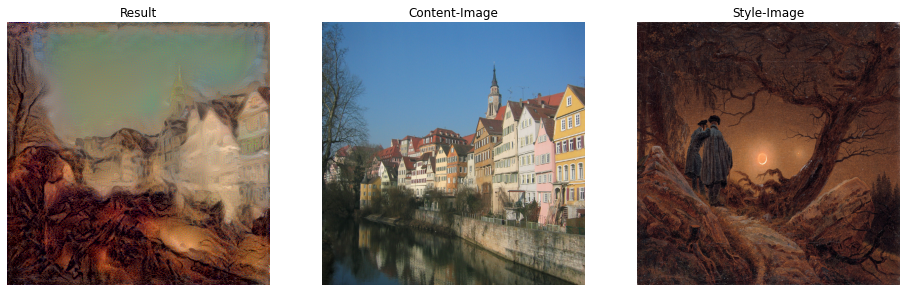

100%|██████████   1000/1000  02:44<00:00   Total Loss:1152644.25   Style Loss:752407.5625   Content Loss:400236.71875


In [ ]:
content_weight = 1e0 
style_weight = 2e0 

n_of_iterations = [50,100,250,500,1000]
for n_iter in n_of_iterations:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Caspar_David_Friedrich_-_Zwei_Männer_in_Betrachtung_des_Mondes.jpg.1',
          num_iterations = n_iter, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = False,
          randomized = False)

100%|██████████   50/50  00:08<00:00   Total Loss:94869040.0   Style Loss:94438168.0   Content Loss:430869.96875

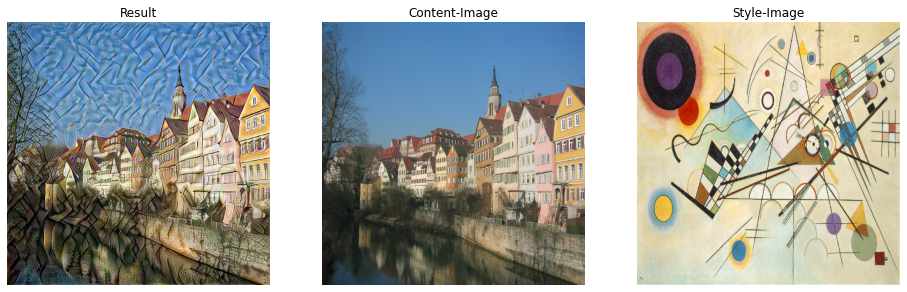

100%|██████████   50/50  00:08<00:00   Total Loss:94869040.0   Style Loss:94438168.0   Content Loss:430869.96875
100%|██████████   100/100  00:16<00:00   Total Loss:47886584.0   Style Loss:47414744.0   Content Loss:471841.65625

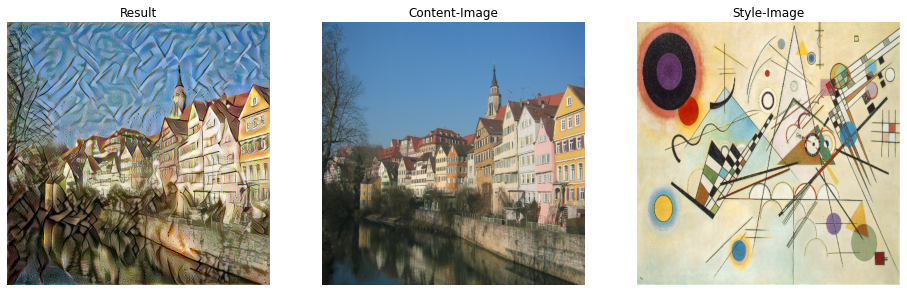

100%|██████████   100/100  00:16<00:00   Total Loss:47886584.0   Style Loss:47414744.0   Content Loss:471841.65625
100%|██████████   250/250  00:40<00:00   Total Loss:16165141.0   Style Loss:15618891.0   Content Loss:546250.375

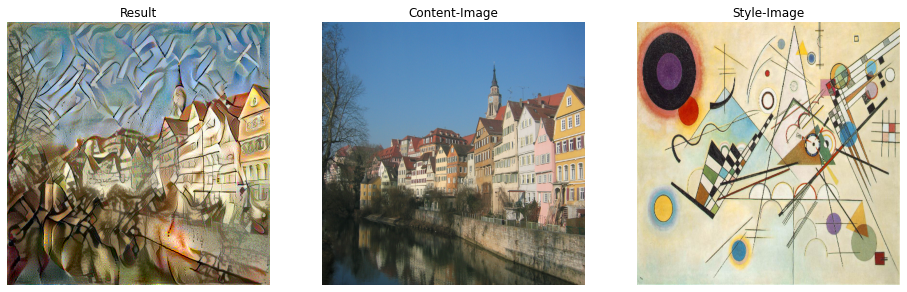

100%|██████████   250/250  00:41<00:00   Total Loss:16165141.0   Style Loss:15618891.0   Content Loss:546250.375
100%|██████████   500/500  01:21<00:00   Total Loss:6741911.0   Style Loss:6149638.0   Content Loss:592272.75  

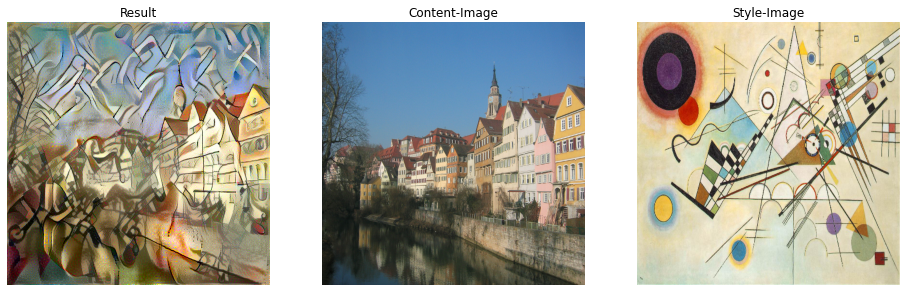

100%|██████████   500/500  01:22<00:00   Total Loss:6741911.0   Style Loss:6149638.0   Content Loss:592272.75
100%|██████████   1000/1000  02:44<00:00   Total Loss:3113481.75   Style Loss:2509940.75   Content Loss:603540.9375

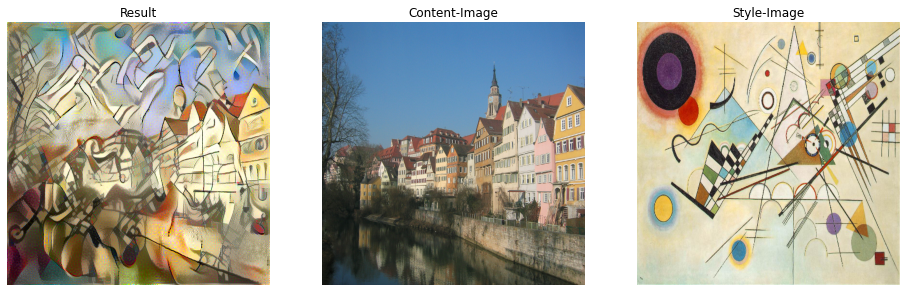

100%|██████████   1000/1000  02:44<00:00   Total Loss:3113481.75   Style Loss:2509940.75   Content Loss:603540.9375


In [ ]:
content_weight = 1e0 
style_weight = 2e0 

n_of_iterations = [50,100,250,500,1000]
for n_iter in n_of_iterations:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/Vassily_Kandinsky,_1923_-_Composition_8,_huile_sur_toile,_140_cm_x_201_cm,_Musée_Guggenheim,_New_York.jpg',
          num_iterations = n_iter, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = False,
          randomized = False)

100%|██████████   50/50  00:08<00:00   Total Loss:30235132.0   Style Loss:29782898.0   Content Loss:452233.03125

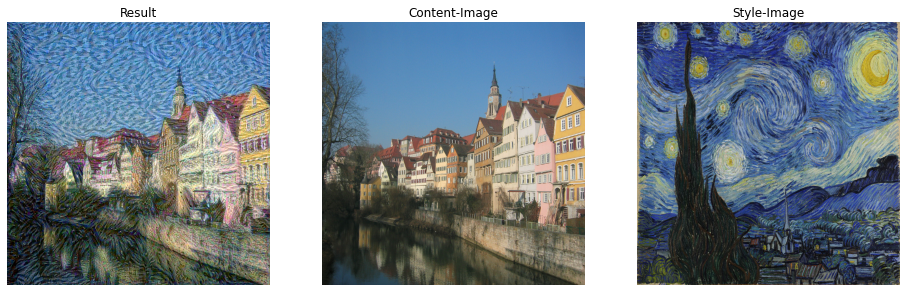

100%|██████████   50/50  00:08<00:00   Total Loss:30235132.0   Style Loss:29782898.0   Content Loss:452233.03125
100%|██████████   100/100  00:16<00:00   Total Loss:9374745.0   Style Loss:8892999.0   Content Loss:481746.0   

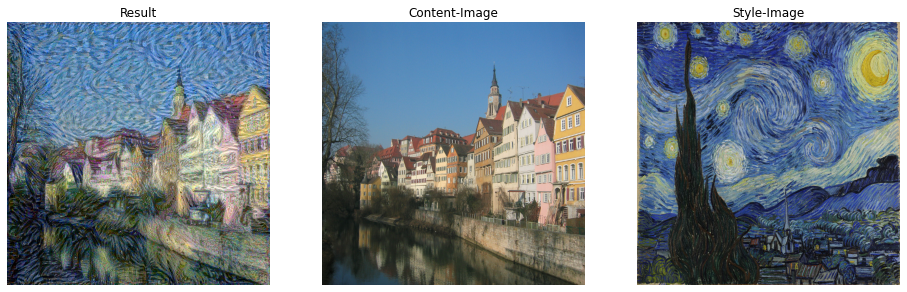

100%|██████████   100/100  00:16<00:00   Total Loss:9374745.0   Style Loss:8892999.0   Content Loss:481746.0
100%|██████████   250/250  00:40<00:00   Total Loss:2599177.25   Style Loss:2078472.625   Content Loss:520704.53125

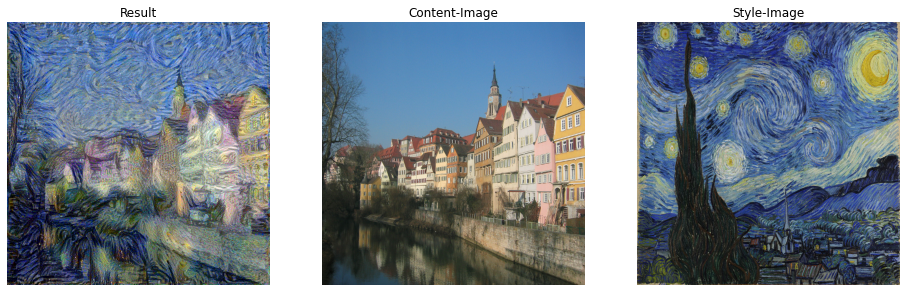

100%|██████████   250/250  00:41<00:00   Total Loss:2599177.25   Style Loss:2078472.625   Content Loss:520704.53125
100%|██████████   500/500  01:22<00:00   Total Loss:1103934.75   Style Loss:584003.875   Content Loss:519930.9375

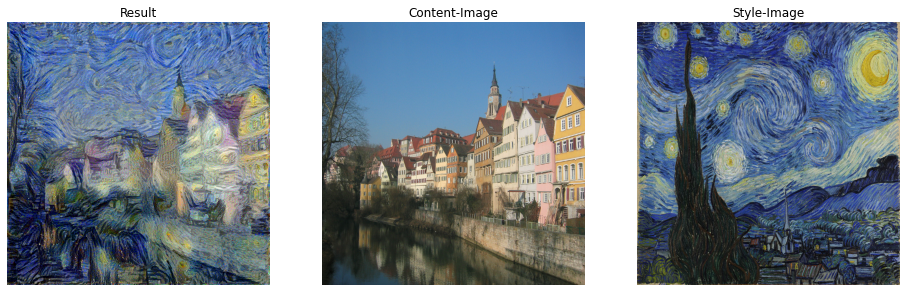

100%|██████████   500/500  01:22<00:00   Total Loss:1103934.75   Style Loss:584003.875   Content Loss:519930.9375
100%|██████████   1000/1000  02:44<00:00   Total Loss:722505.0625   Style Loss:244309.234375   Content Loss:478195.8125

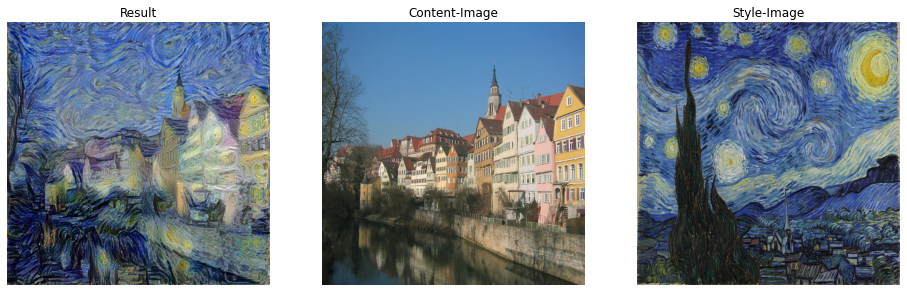

100%|██████████   1000/1000  02:44<00:00   Total Loss:722505.0625   Style Loss:244309.234375   Content Loss:478195.8125


In [ ]:

content_weight = 1e0 
style_weight = 2e0 

n_of_iterations = [50,100,250,500,1000]
for n_iter in n_of_iterations:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg',
          num_iterations = n_iter, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = 2.5,
          avg_pool = False,
          randomized =False)

##Variation: Different Learning rates

100%|██████████   500/500  01:21<00:00   Total Loss:214731776.0   Style Loss:214612176.0   Content Loss:119597.3046875

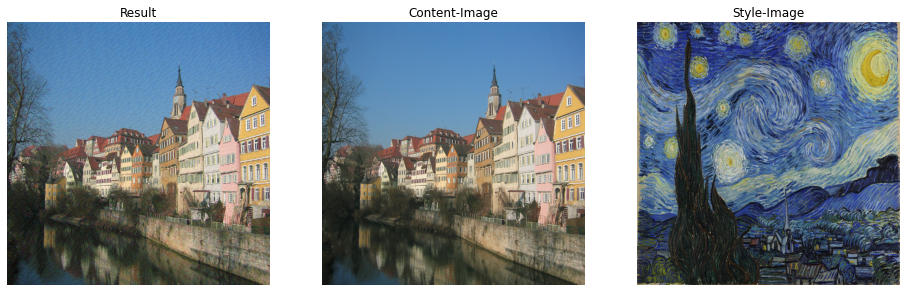

100%|██████████   500/500  01:21<00:00   Total Loss:214731776.0   Style Loss:214612176.0   Content Loss:119597.3046875
100%|██████████   500/500  01:22<00:00   Total Loss:1878931.5   Style Loss:1378268.875   Content Loss:500662.59375

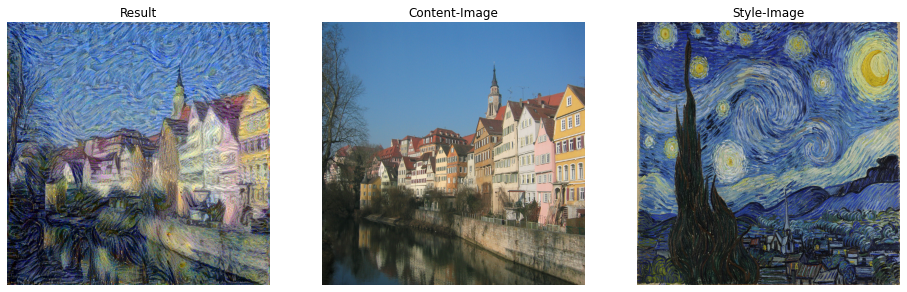

100%|██████████   500/500  01:22<00:00   Total Loss:1878931.5   Style Loss:1378268.875   Content Loss:500662.59375
100%|██████████   500/500  01:22<00:00   Total Loss:1103511.25   Style Loss:583605.5   Content Loss:519905.8125    

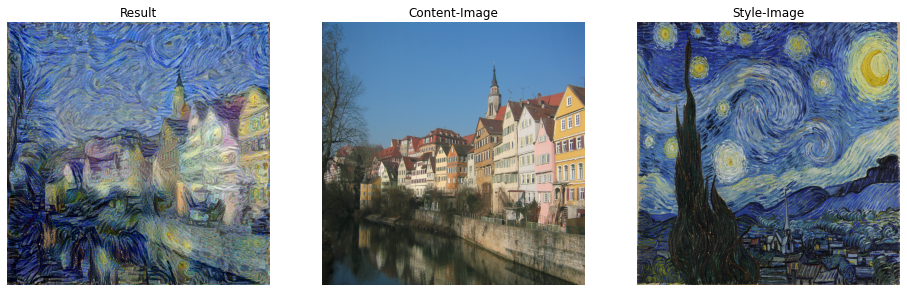

100%|██████████   500/500  01:22<00:00   Total Loss:1103511.25   Style Loss:583605.5   Content Loss:519905.8125
100%|██████████   500/500  01:22<00:00   Total Loss:939475.375   Style Loss:404669.28125   Content Loss:534806.125

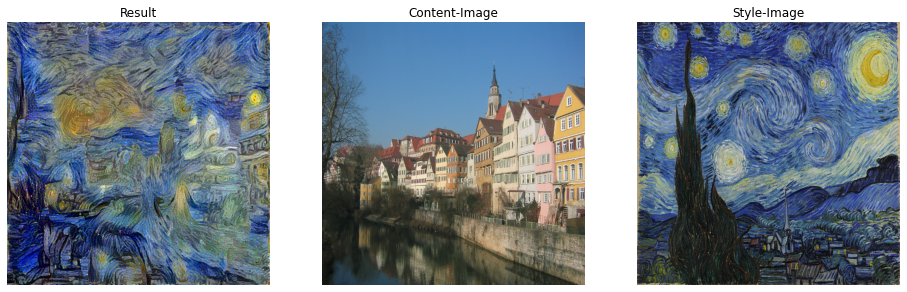

100%|██████████   500/500  01:22<00:00   Total Loss:939475.375   Style Loss:404669.28125   Content Loss:534806.125
100%|██████████   500/500  01:22<00:00   Total Loss:964495.625   Style Loss:385001.46875   Content Loss:579494.1875

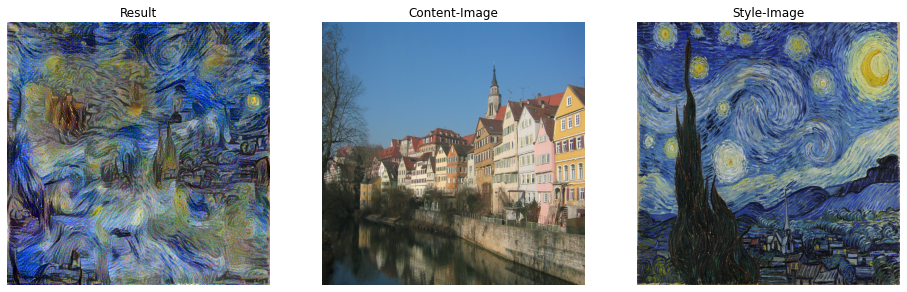

100%|██████████   500/500  01:22<00:00   Total Loss:964495.625   Style Loss:385001.46875   Content Loss:579494.1875


In [ ]:

content_weight = 1e0 
style_weight = 2e0 

learning_rates = [0.01,1,2.5,10,20]
for rate in learning_rates:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = rate,
          avg_pool = False,
          randomized = False)



100%|██████████   500/500  01:21<00:00   Total Loss:445258304.0   Style Loss:445140704.0   Content Loss:117585.6953125

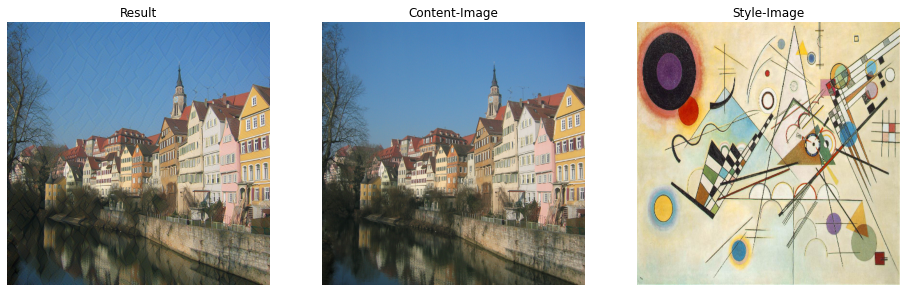

100%|██████████   500/500  01:21<00:00   Total Loss:445258304.0   Style Loss:445140704.0   Content Loss:117585.6953125
100%|██████████   500/500  01:22<00:00   Total Loss:12730367.0   Style Loss:12199670.0   Content Loss:530697.125 

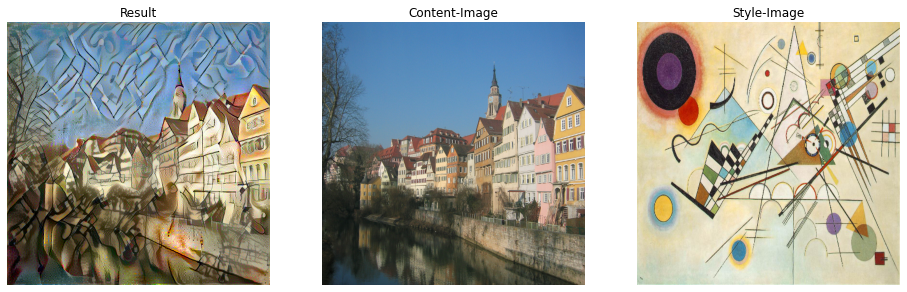

100%|██████████   500/500  01:22<00:00   Total Loss:12730367.0   Style Loss:12199670.0   Content Loss:530697.125
100%|██████████   500/500  01:21<00:00   Total Loss:6751073.5   Style Loss:6159101.5   Content Loss:591971.8125

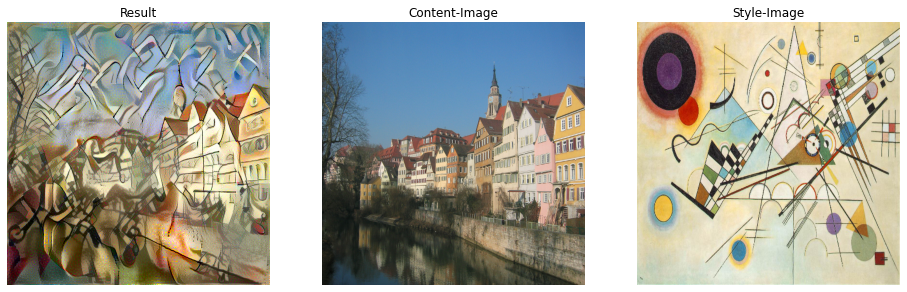

100%|██████████   500/500  01:22<00:00   Total Loss:6751073.5   Style Loss:6159101.5   Content Loss:591971.8125
100%|██████████   500/500  01:22<00:00   Total Loss:2589559.0   Style Loss:1929971.375   Content Loss:659587.625

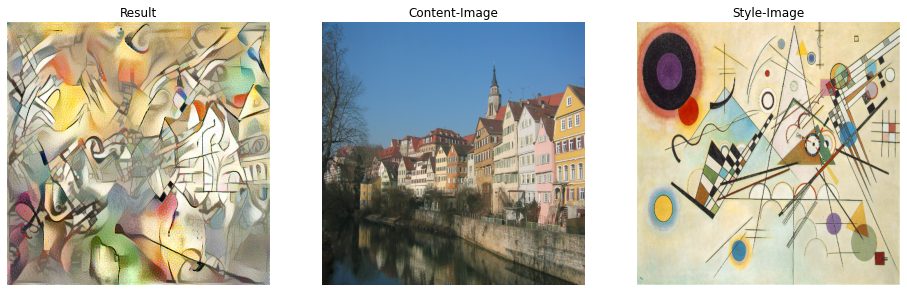

100%|██████████   500/500  01:22<00:00   Total Loss:2589559.0   Style Loss:1929971.375   Content Loss:659587.625
100%|██████████   500/500  01:22<00:00   Total Loss:2843045.25   Style Loss:2155186.75   Content Loss:687858.5 

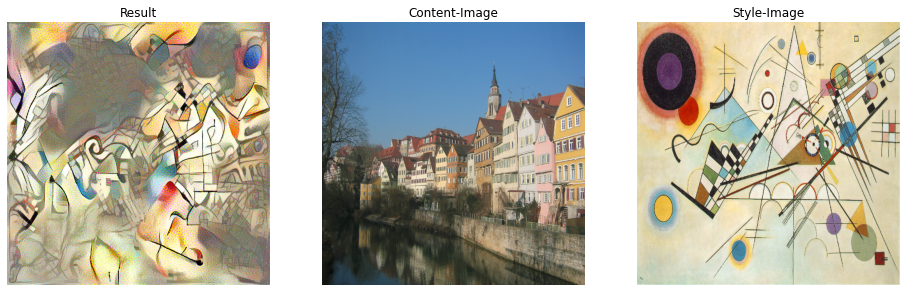

100%|██████████   500/500  01:22<00:00   Total Loss:2843045.25   Style Loss:2155186.75   Content Loss:687858.5


In [ ]:
content_weight = 1e0 
style_weight = 2e0 


for rate in learning_rates:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/Vassily_Kandinsky,_1923_-_Composition_8,_huile_sur_toile,_140_cm_x_201_cm,_Musée_Guggenheim,_New_York.jpg',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = rate,
          avg_pool = False,
          randomized = False)


100%|██████████   500/500  01:21<00:00   Total Loss:212075632.0   Style Loss:211981328.0   Content Loss:94311.4375   

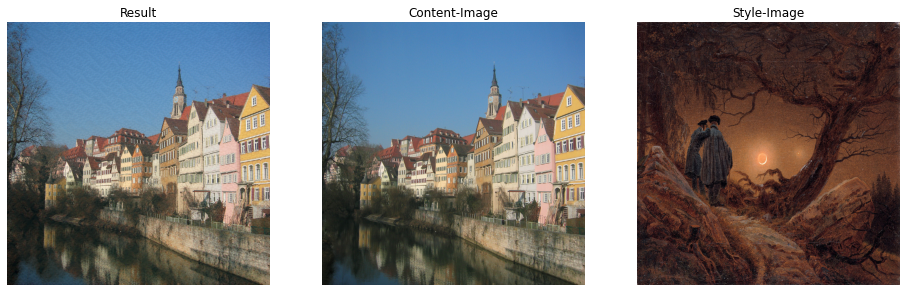

100%|██████████   500/500  01:21<00:00   Total Loss:212075632.0   Style Loss:211981328.0   Content Loss:94311.4375
100%|██████████   500/500  01:22<00:00   Total Loss:3147492.0   Style Loss:2710596.25   Content Loss:436895.8125

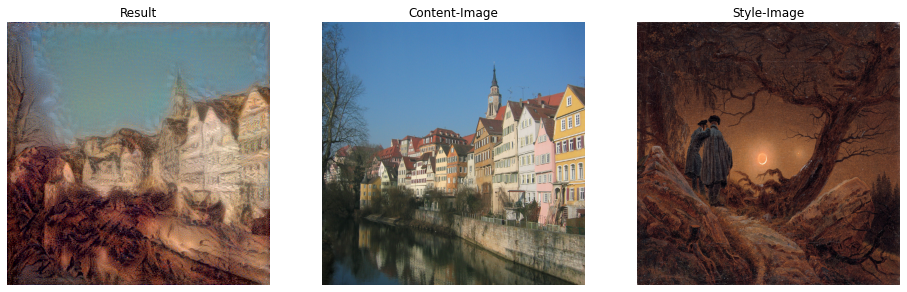

100%|██████████   500/500  01:22<00:00   Total Loss:3147492.0   Style Loss:2710596.25   Content Loss:436895.8125
100%|██████████   500/500  01:21<00:00   Total Loss:2154311.0   Style Loss:1708724.375   Content Loss:445586.75  

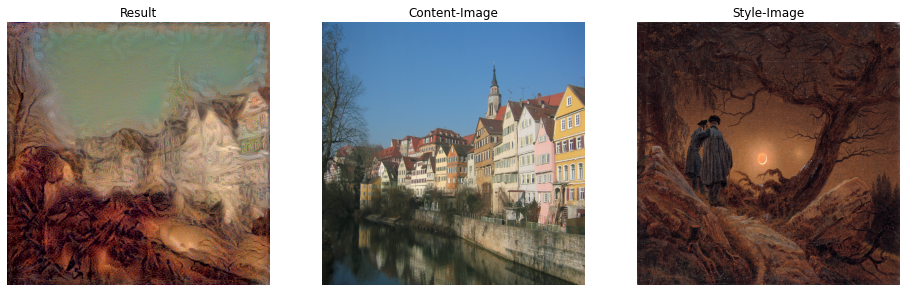

100%|██████████   500/500  01:22<00:00   Total Loss:2154311.0   Style Loss:1708724.375   Content Loss:445586.75
100%|██████████   500/500  01:22<00:00   Total Loss:1027545.25   Style Loss:580993.5625   Content Loss:446551.71875

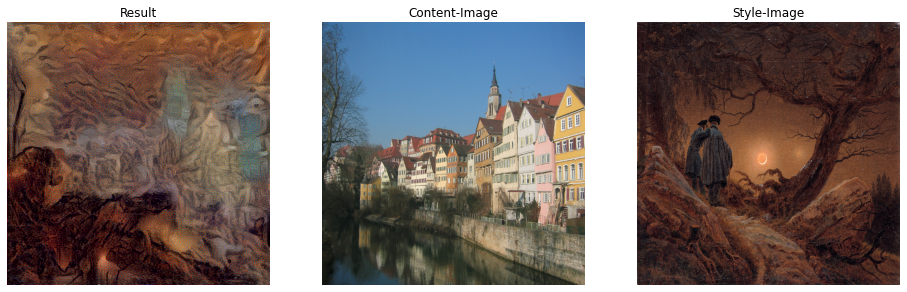

100%|██████████   500/500  01:23<00:00   Total Loss:1027545.25   Style Loss:580993.5625   Content Loss:446551.71875
100%|██████████   500/500  01:22<00:00   Total Loss:1328265.0   Style Loss:857452.625   Content Loss:470812.4375  

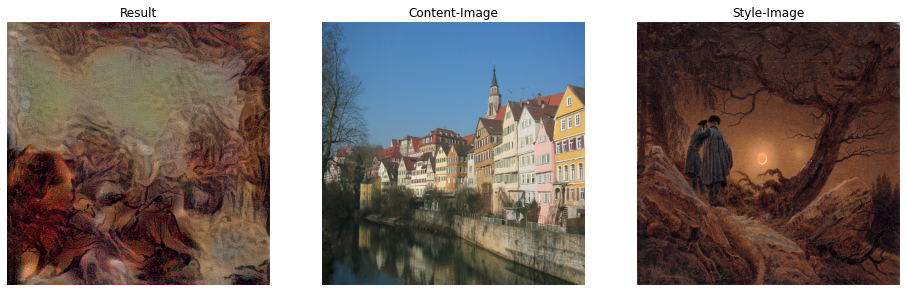

100%|██████████   500/500  01:22<00:00   Total Loss:1328265.0   Style Loss:857452.625   Content Loss:470812.4375


In [ ]:
content_weight = 1e0 
style_weight = 2e0 


for rate in learning_rates:
  pics, best_image =optimize(content_path = content_path, 
          style_path = '/tmp/nst/1024px-Caspar_David_Friedrich_-_Zwei_Männer_in_Betrachtung_des_Mondes.jpg.1',
          num_iterations = 500, 
          content_layer_num = 6, #which layer of content
          style_layers_num = 5, #how many style layers
          content_weight = content_weight,
          style_weight = style_weight,
          learning_rate = rate,
          avg_pool = False,
          randomized = False)
